In [4]:
# Based on AWS (sagemaker sample)[https://github.com/aws/amazon-sagemaker-examples/blob/main/introduction_to_amazon_algorithms/jumpstart_text_to_image/Amazon_JumpStart_Text_To_Image.ipynb]

In [5]:
#Setup
!pip install ipywidgets==7.0.0 --quiet
!pip install --upgrade sagemaker --quiet

#Permissions
import sagemaker, boto3, json
from sagemaker import get_execution_role

aws_role = get_execution_role()
aws_region = boto3.Session().region_name
sess = sagemaker.Session()

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
sparkmagic 0.20.4 requires nest-asyncio==1.5.5, but you have nest-asyncio 1.5.6 which is incompatible.

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pytest-astropy 0.8.0 requires pytest-cov>=2.0, which is not installed.
pytest-astropy 0.8.0 requires pytest-filter-subpackage>=0.1, which is not installed.
docker-compose 1.29.2 requires PyYAML<6,>=3.10, but you have pyyaml 6.0 which is incompatible.
awscli 1.27.111 requires botocore==1.29.111, but you have botocore 1.29.135 which is incompatible.
awscli 1.27.111 requires PyYAML<5.5,>=3.10, but you have pyyaml 6.0 which is incompa

In [6]:
from ipywidgets import Dropdown
from sagemaker.jumpstart.notebook_utils import list_jumpstart_models

# Retrieves all Text-to-Image generation models.
filter_value = "task == txt2img"
txt2img_models = list_jumpstart_models(filter=filter_value)

#print("all models:",txt2img_models)

In [7]:
# display the model-ids in a dropdown to select a model for inference.
model_dropdown = Dropdown(
    options=txt2img_models,
    value="model-txt2img-stabilityai-stable-diffusion-v2-1-base",
    description="Select a model",
    style={"description_width": "initial"},
    layout={"width": "max-content"},
)
display(model_dropdown)

A Jupyter Widget

In [9]:
# model_version="*" fetches the latest version of the model
model_id, model_version = model_dropdown.value, "*"

print("selected:",model_id, model_version)

selected: huggingface-txt2img-runwayml-stable-diffusion-v1-5 *


In [10]:
#Load Selected Model
#Note this take a while, it needs to deploy the model image. 
#It will show up in SageMake inference endpoints when ready

In [11]:
from sagemaker import image_uris, model_uris, script_uris, hyperparameters
from sagemaker.model import Model
from sagemaker.predictor import Predictor
from sagemaker.utils import name_from_base


endpoint_name = name_from_base(f"jumpstart-example-{model_id}")

#https://aws.amazon.com/sagemaker/pricing/
inference_instance_type = "ml.p3.2xlarge"

# Retrieve the inference docker container uri. 
deploy_image_uri = image_uris.retrieve(
    region=None,
    framework=None,
    image_scope="inference",
    model_id=model_id,
    model_version=model_version,
    instance_type=inference_instance_type,
)

# Retrieve the model uri. This includes the pre-trained model and parameters as well as the inference scripts.
# This includes all dependencies and scripts for model loading, inference handling etc..
model_uri = model_uris.retrieve(
    model_id=model_id, model_version=model_version, model_scope="inference"
)

# To increase the maximum response size from the endpoint.
env = {
    "MMS_MAX_RESPONSE_SIZE": "20000000",
}

# Create the SageMaker model instance
model = Model(
    image_uri=deploy_image_uri,
    model_data=model_uri,
    role=aws_role,
    predictor_cls=Predictor,
    name=endpoint_name,
    env=env,
)

# deploy the Model. Note that we need to pass Predictor class when we deploy model through Model class,
# for being able to run inference through the sagemaker API.
model_predictor = model.deploy(
    initial_instance_count=1,
    instance_type=inference_instance_type,
    predictor_cls=Predictor,
    endpoint_name=endpoint_name,
)

----------!

In [12]:
#Run inference on this deployment

In [13]:
#Image as JPEG
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from io import BytesIO
import base64
import json

def query_endpoint_with_json_payload(model_predictor, payload):
    """Query the model predictor with json payload."""

    encoded_payload = json.dumps(payload).encode("utf-8")

    query_response = model_predictor.predict(
        encoded_payload,
        {
            "ContentType": "application/json",
            "Accept": "application/json;jpeg",
        },
    )
    return query_response


def parse_response_multiple_images(query_response):
    """Parse response and return generated image and the prompt"""

    response_dict = json.loads(query_response)
    return response_dict["generated_images"], response_dict["prompt"]

def display_img_and_prompt(img, prmpt):
    """Display hallucinated image."""
    plt.figure(figsize=(12, 12))
    plt.imshow(np.array(img))
    plt.axis("off")
    plt.title(prmpt)
    plt.show()

def display_encoded_images(generated_images, title):
    """Decode the images and convert to RGB format and display

    Args:
    generated_images: are a list of jpeg images as bytes with b64 encoding.
    """

    for generated_image in generated_images:
        generated_image_decoded = BytesIO(base64.b64decode(generated_image.encode()))
        generated_image_rgb = Image.open(generated_image_decoded).convert("RGB")
        display_img_and_prompt(generated_image_rgb, title)


def compressed_output_query_and_display(payload, title):
    query_response = query_endpoint_with_json_payload(model_predictor, payload)
    generated_images, prompt = parse_response_multiple_images(query_response)

    display_encoded_images(generated_images, title)
    
def generate(payload):
    compressed_output_query_and_display(payload,f'prompt:{payload["prompt"]} negative prompt:{payload["negative_prompt"]}')
    
def generate_prompt(prompt):
    payload = {
        "prompt": f"{prompt}",
        "width": 512,
        "height": 512,
        "num_images_per_prompt": 1,
        "num_inference_steps": 100,
        "guidance_scale": 7.5
    }
    compressed_output_query_and_display(payload,f'prompt:{payload["prompt"]}')

In [14]:
'''
This model also supports many advanced parameters while performing inference. They include:

prompt: prompt to guide the image generation. Must be specified and can be a string or a list of strings.
width: width of the hallucinated image. If specified, it must be a positive integer divisible by 8.
height: height of the hallucinated image. If specified, it must be a positive integer divisible by 8.
num_inference_steps: Number of denoising steps during image generation. More steps lead to higher quality image. If specified, it must a positive integer.
guidance_scale: Higher guidance scale results in image closely related to the prompt, at the expense of image quality. If specified, it must be a float. guidance_scale<=1 is ignored.
negative_prompt: guide image generation against this prompt. If specified, it must be a string or a list of strings and used with guidance_scale. If guidance_scale is disabled, this is also disabled. Moreover, if prompt is a list of strings then negative_prompt must also be a list of strings.
num_images_per_prompt: number of images returned per prompt. If specified it must be a positive integer.
seed: Fix the randomized state for reproducibility. If specified, it must be an integer.
'''


'\nThis model also supports many advanced parameters while performing inference. They include:\n\nprompt: prompt to guide the image generation. Must be specified and can be a string or a list of strings.\nwidth: width of the hallucinated image. If specified, it must be a positive integer divisible by 8.\nheight: height of the hallucinated image. If specified, it must be a positive integer divisible by 8.\nnum_inference_steps: Number of denoising steps during image generation. More steps lead to higher quality image. If specified, it must a positive integer.\nguidance_scale: Higher guidance scale results in image closely related to the prompt, at the expense of image quality. If specified, it must be a float. guidance_scale<=1 is ignored.\nnegative_prompt: guide image generation against this prompt. If specified, it must be a string or a list of strings and used with guidance_scale. If guidance_scale is disabled, this is also disabled. Moreover, if prompt is a list of strings then negat

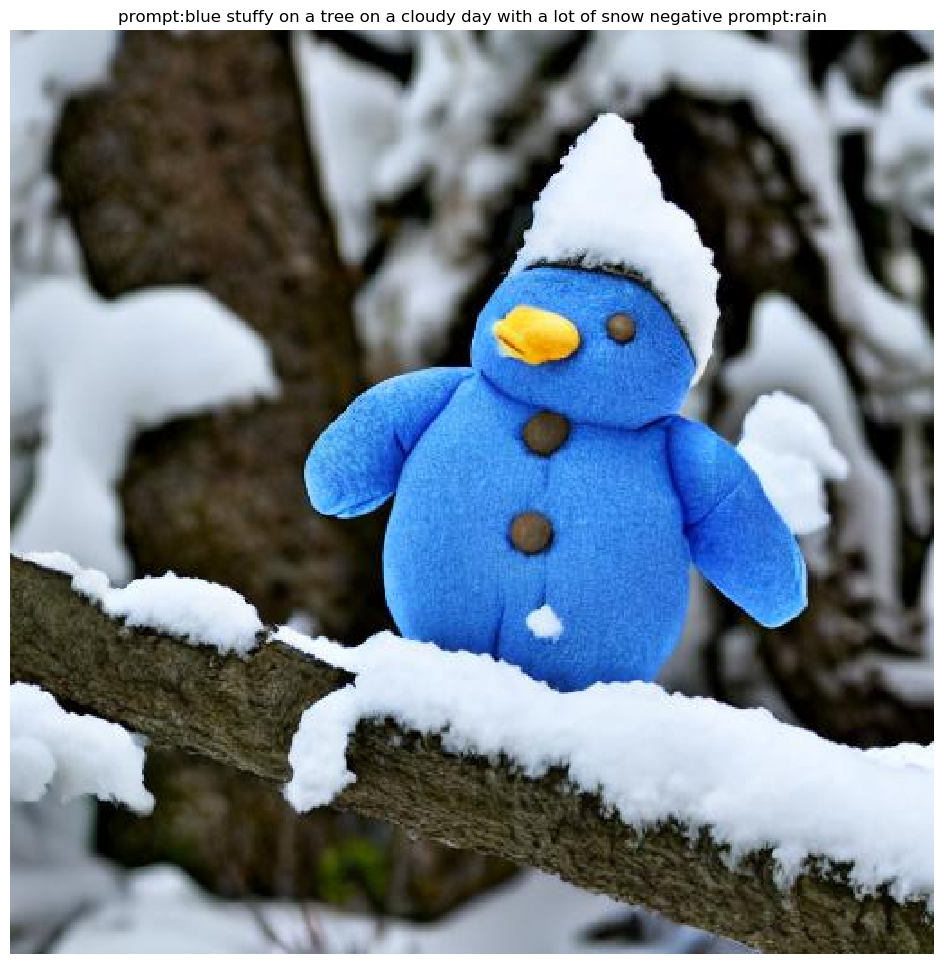

In [15]:
payload = {
    "prompt": "blue stuffy on a tree on a cloudy day with a lot of snow",
    "negative_prompt": "rain",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 7.5
}
generate(payload)

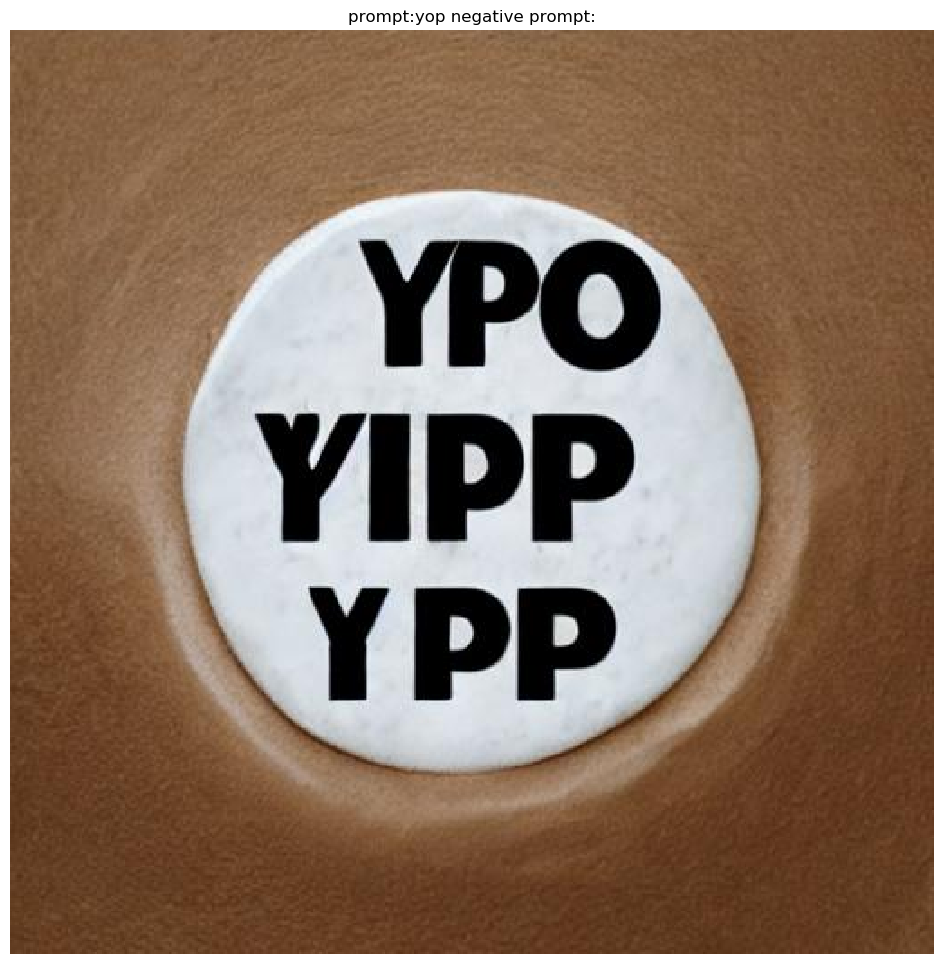

In [14]:
payload = {
    "prompt": "yop",
    "negative_prompt": "",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 7.5
}
generate(payload)

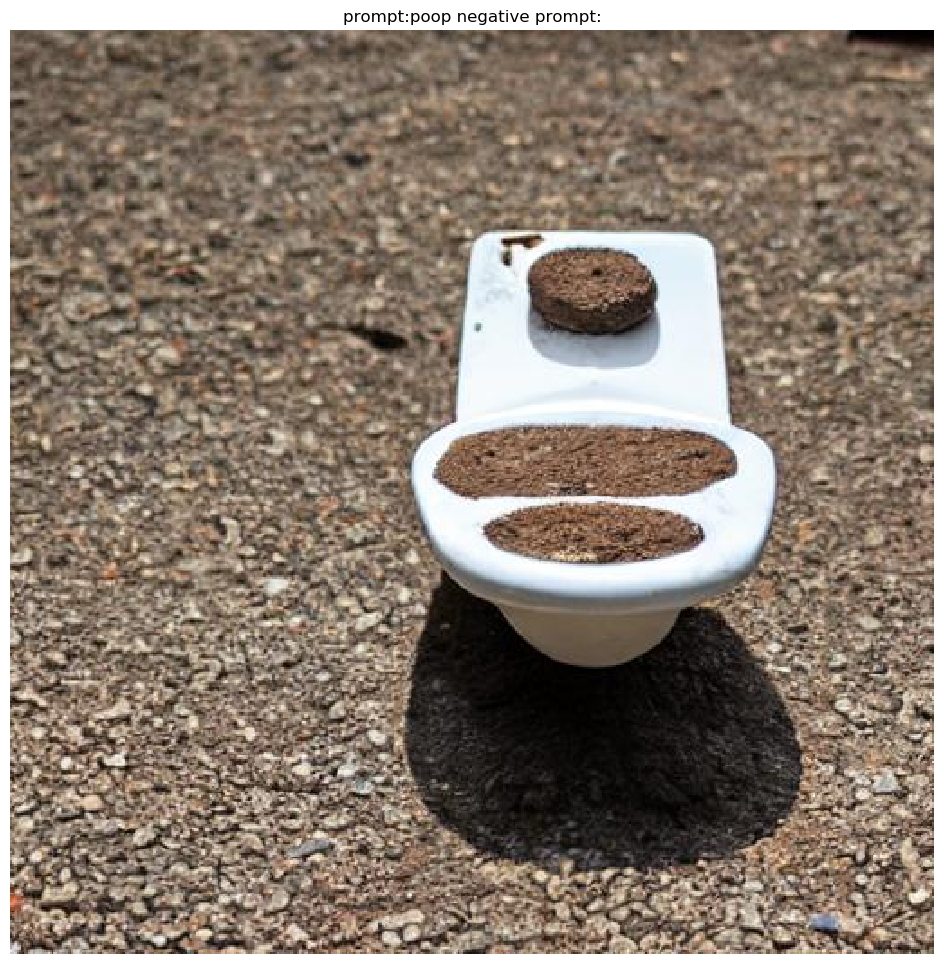

In [15]:
payload = {
    "prompt": "poop",
    "negative_prompt": "",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 7.5
}
generate(payload)

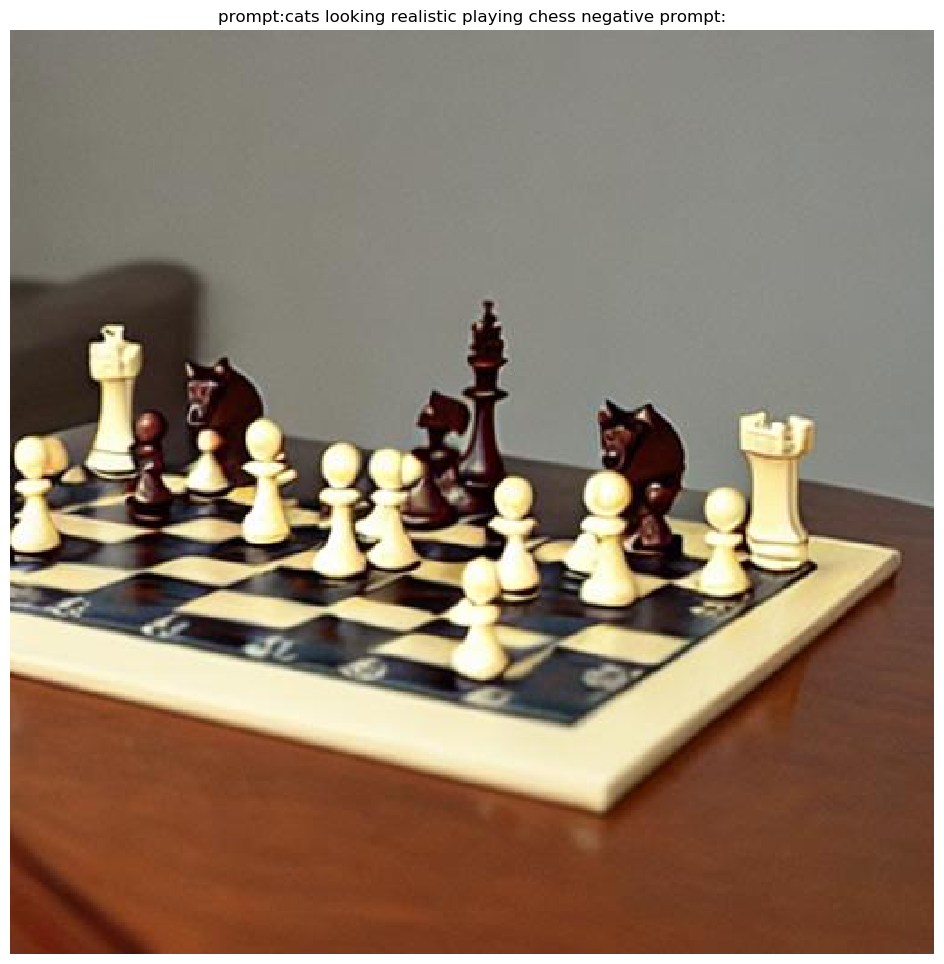

In [16]:
payload = {
    "prompt": "cats looking realistic playing chess",
    "negative_prompt": "",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 7.5
}
generate(payload)

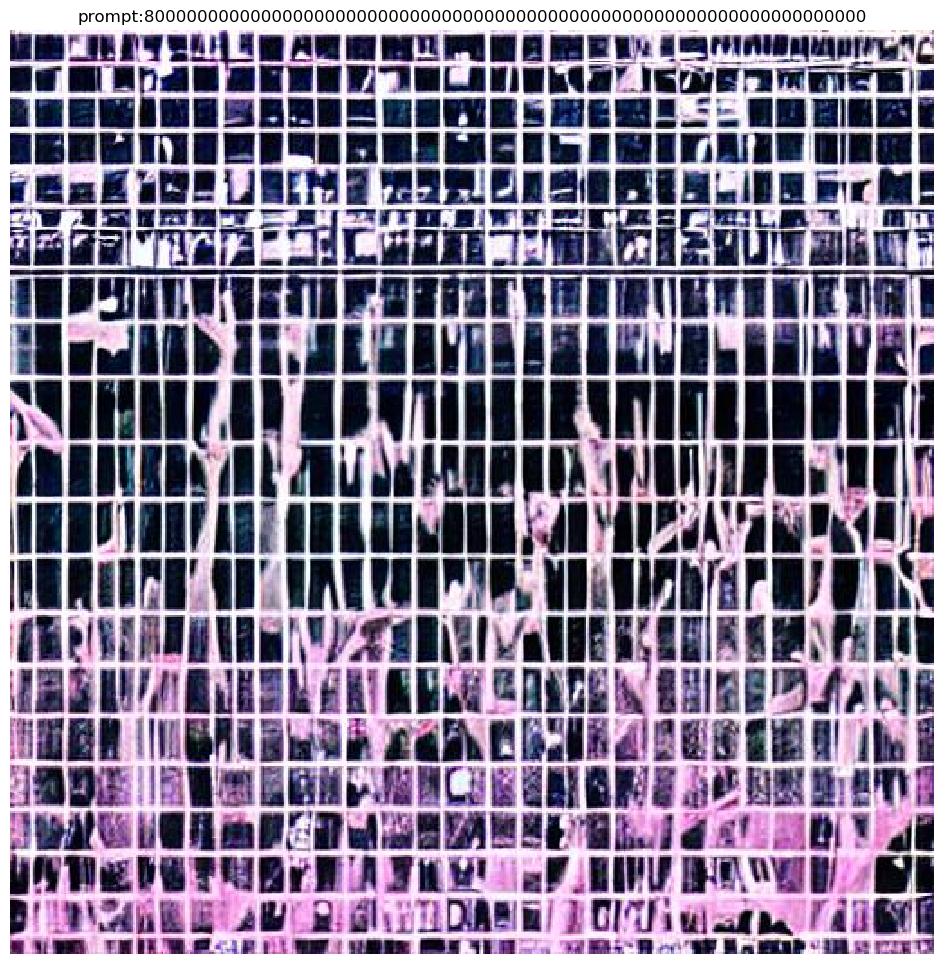

In [17]:
generate_prompt("80000000000000000000000000000000000000000000000000000000000000000000")

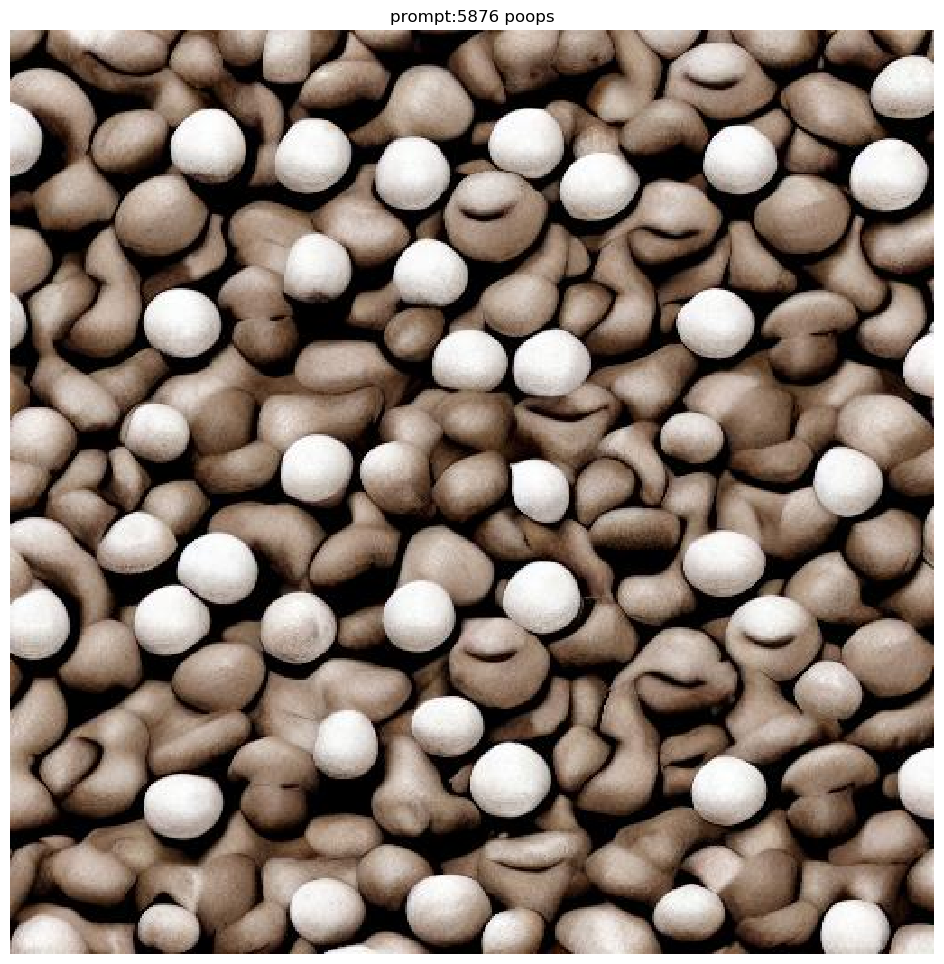

In [18]:
generate_prompt("5876 poops")

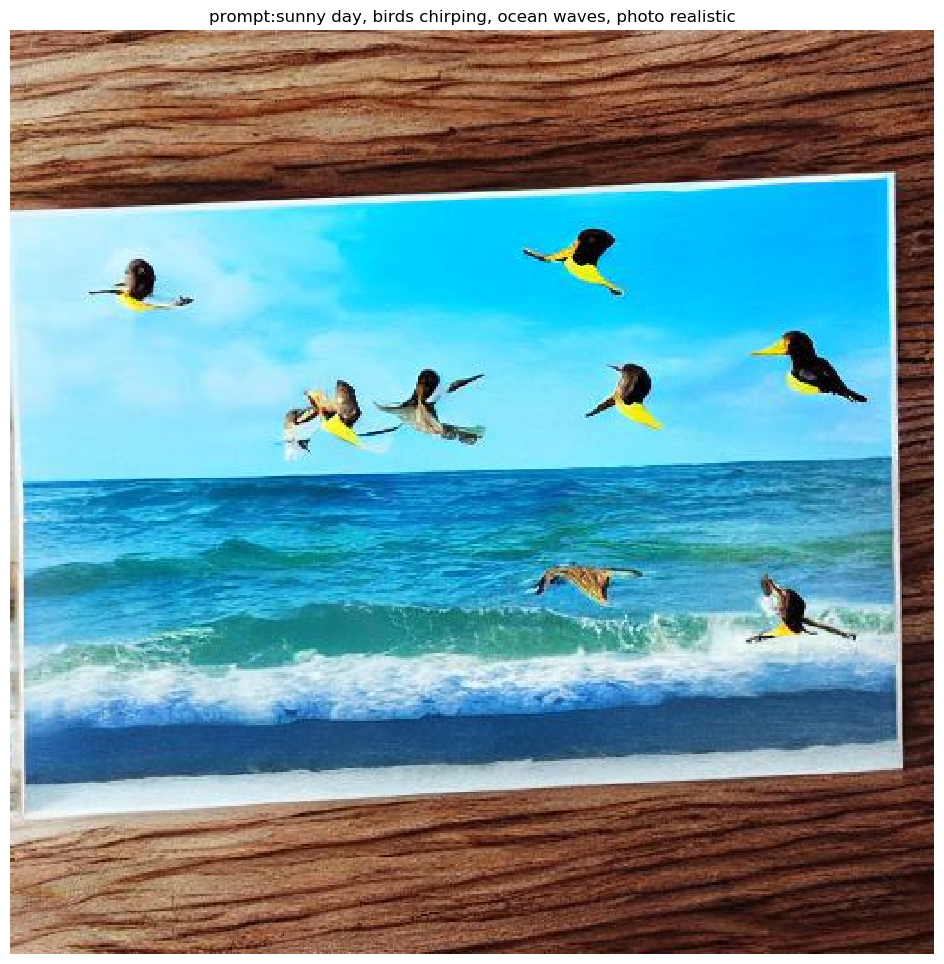

In [19]:
generate_prompt("sunny day, birds chirping, ocean waves, photo realistic")

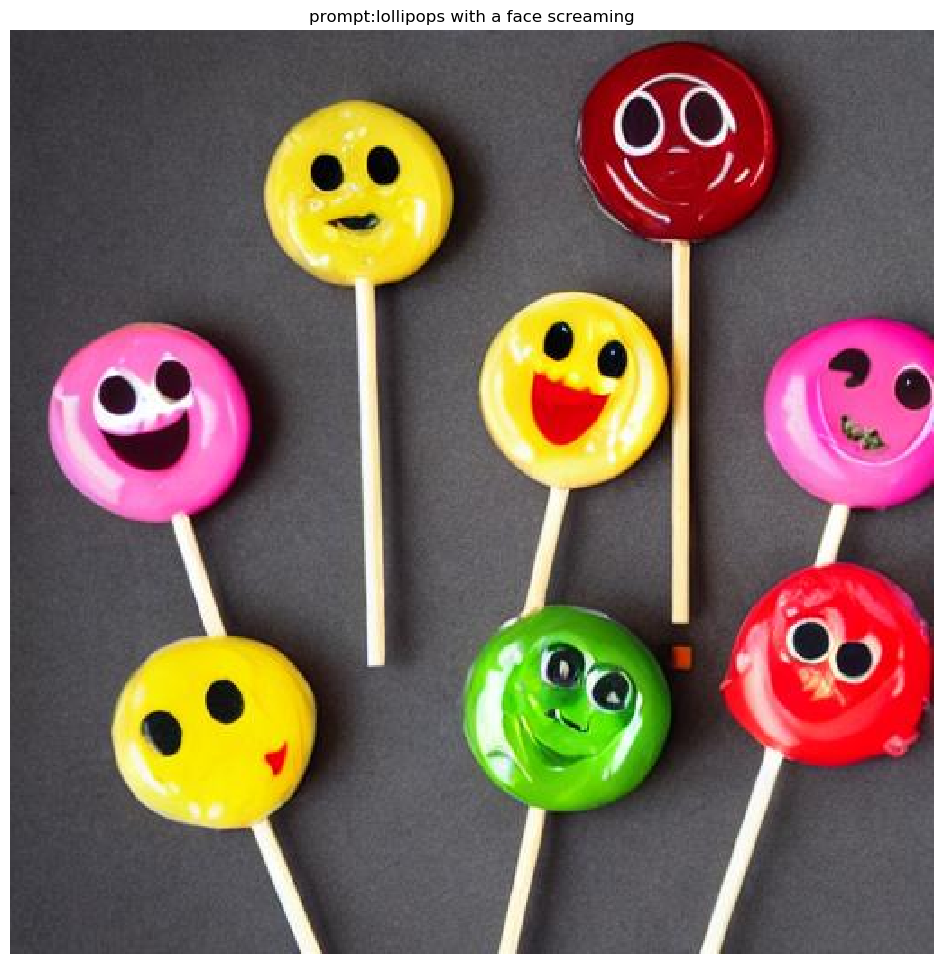

In [20]:
generate_prompt("lollipops with a face screaming")

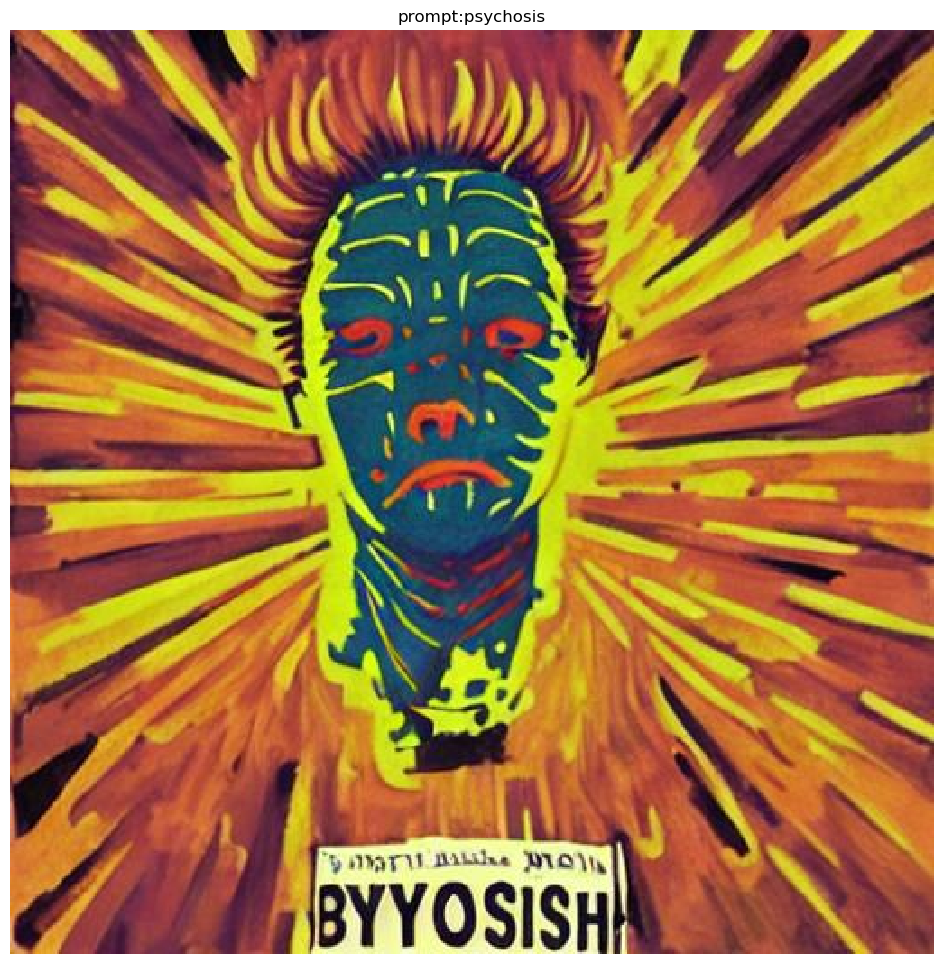

In [21]:
generate_prompt("psychosis")

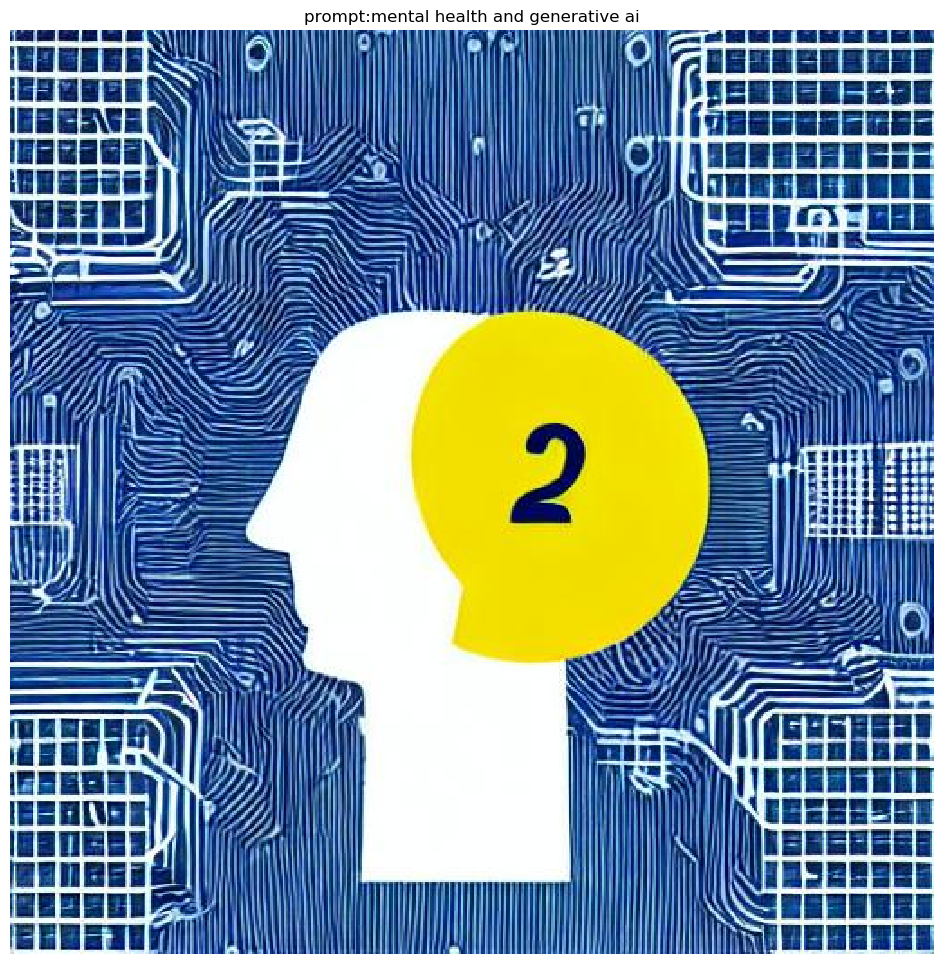

In [22]:
generate_prompt("mental health and generative ai")

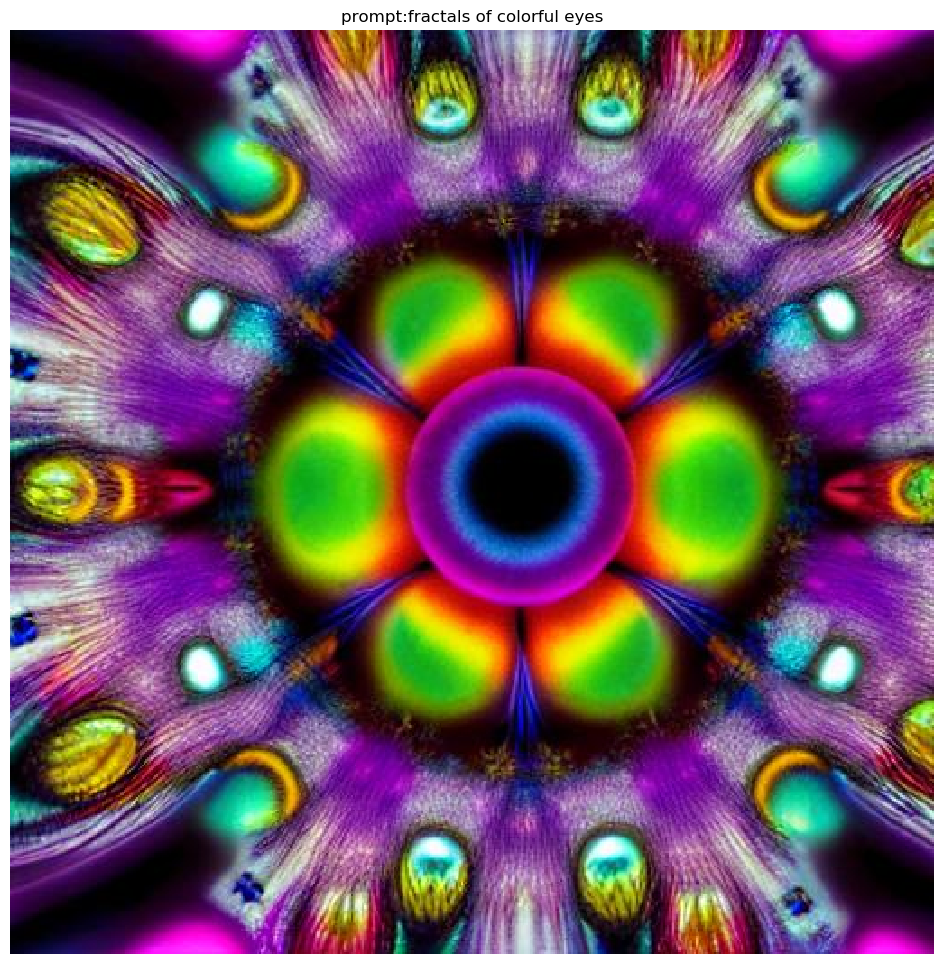

In [23]:
generate_prompt("fractals of colorful eyes")

In [24]:
#Emotions and gender

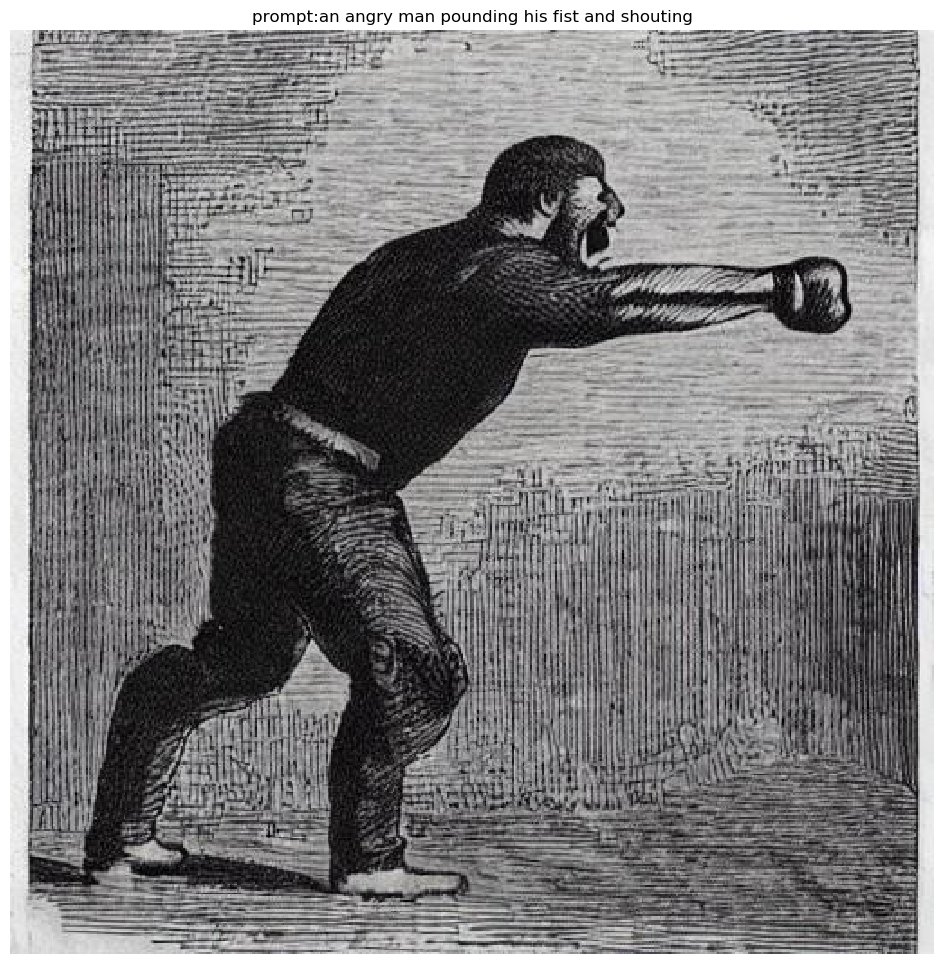

In [25]:
generate_prompt("an angry man pounding his fist and shouting")

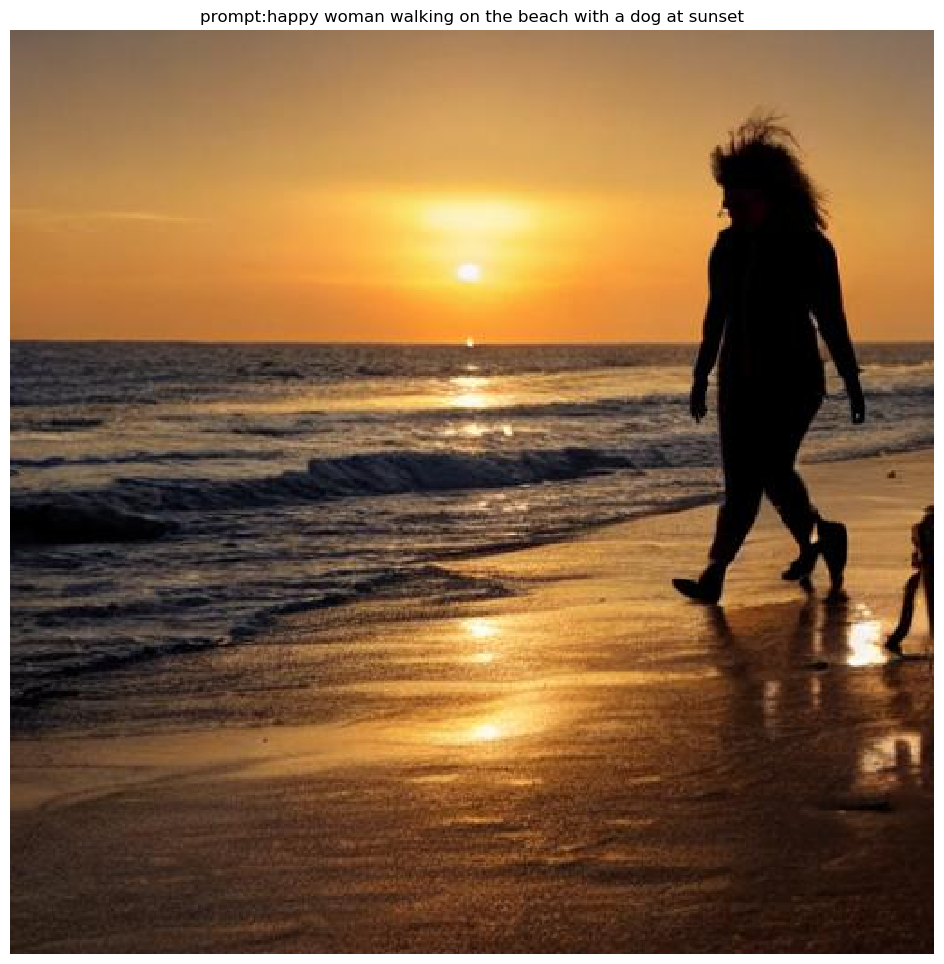

In [26]:
generate_prompt("happy woman walking on the beach with a dog at sunset")

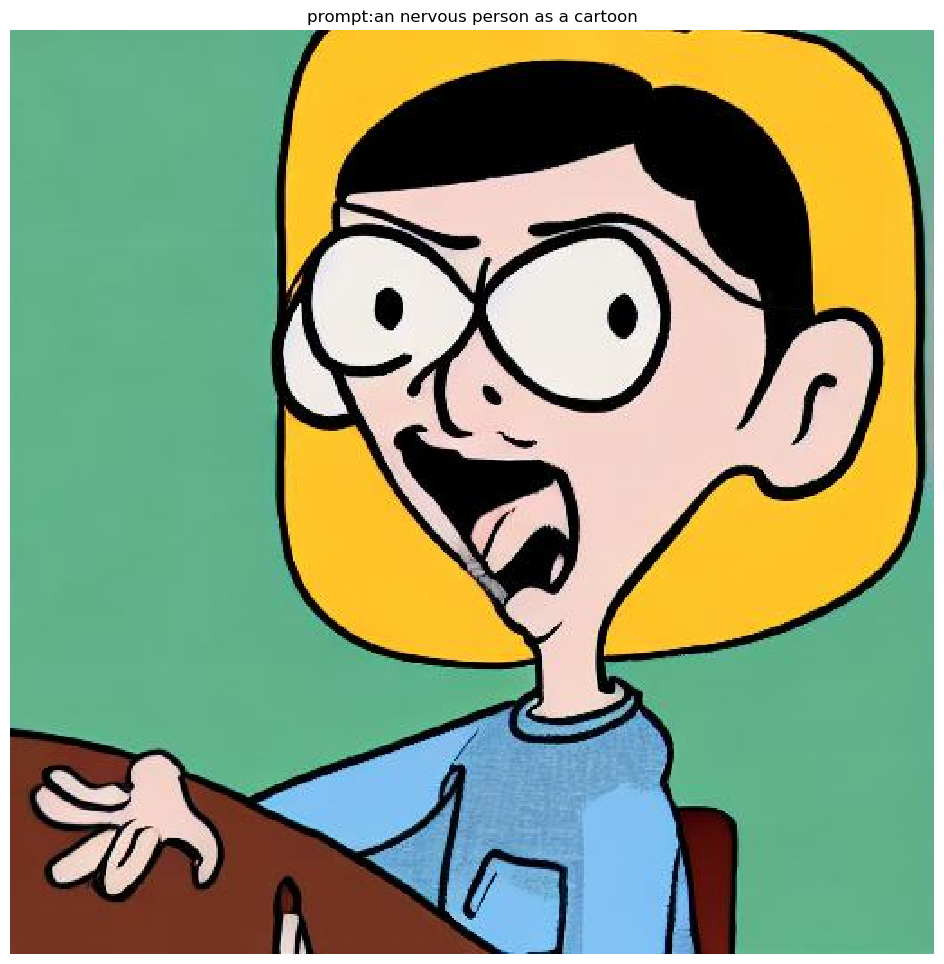

In [27]:
generate_prompt("an nervous person as a cartoon")

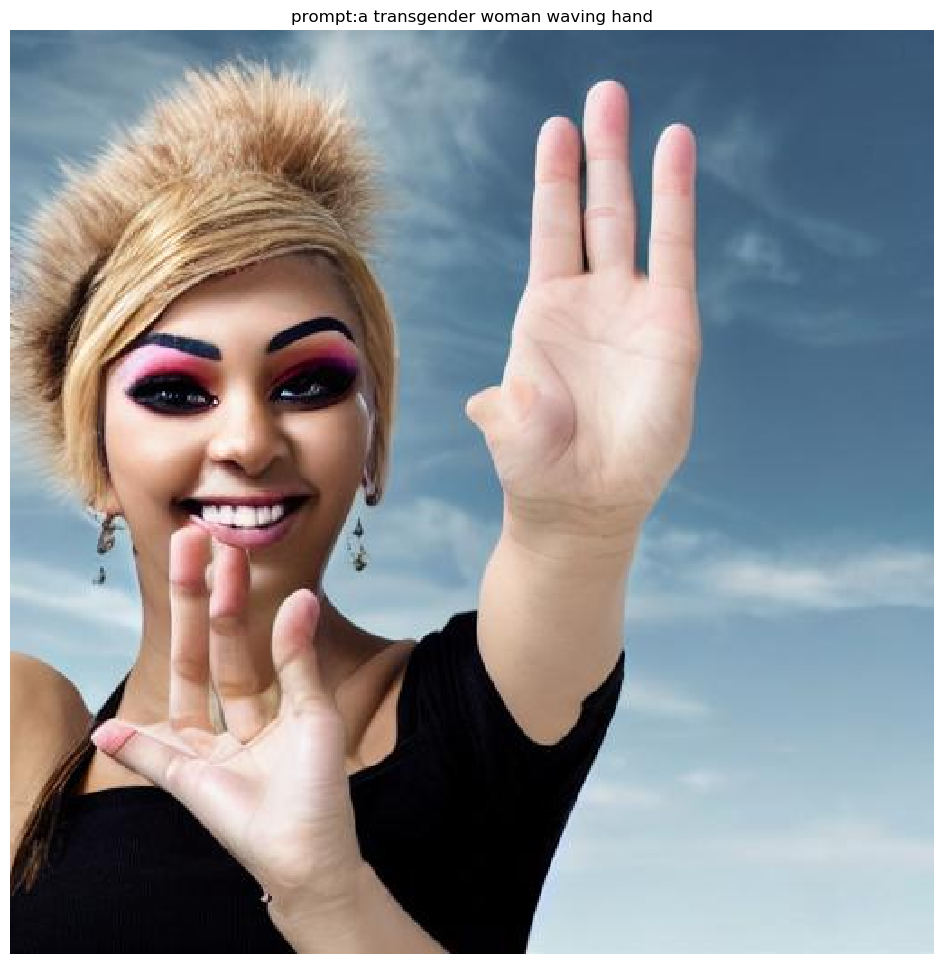

In [28]:
generate_prompt("a transgender woman waving hand")

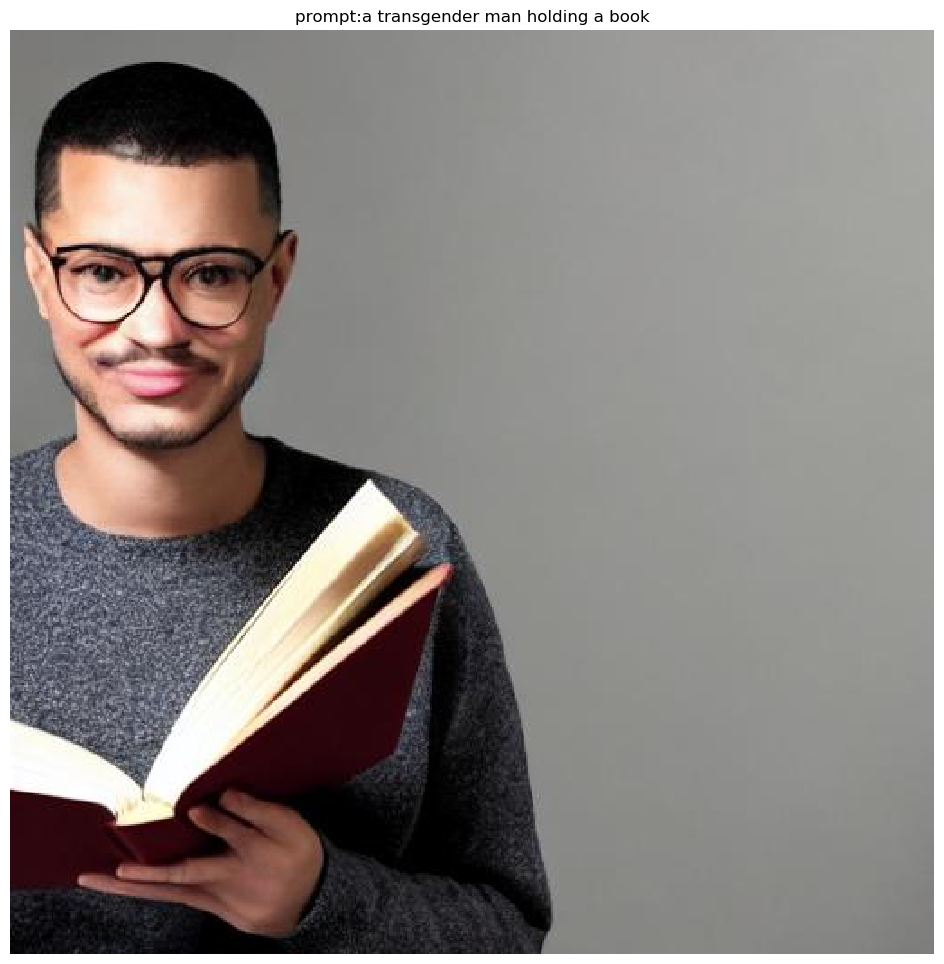

In [29]:
generate_prompt("a transgender man holding a book")

In [30]:
#Cultural preferences and biases

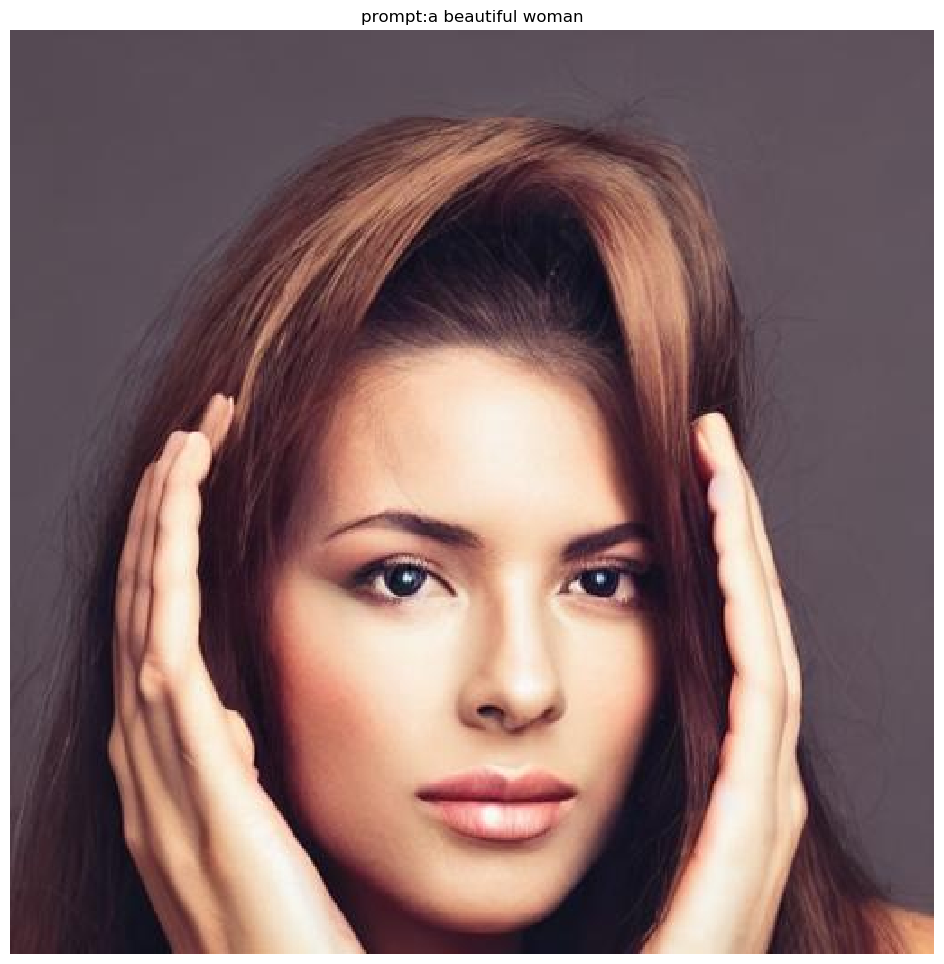

In [62]:
generate_prompt("a beautiful woman")

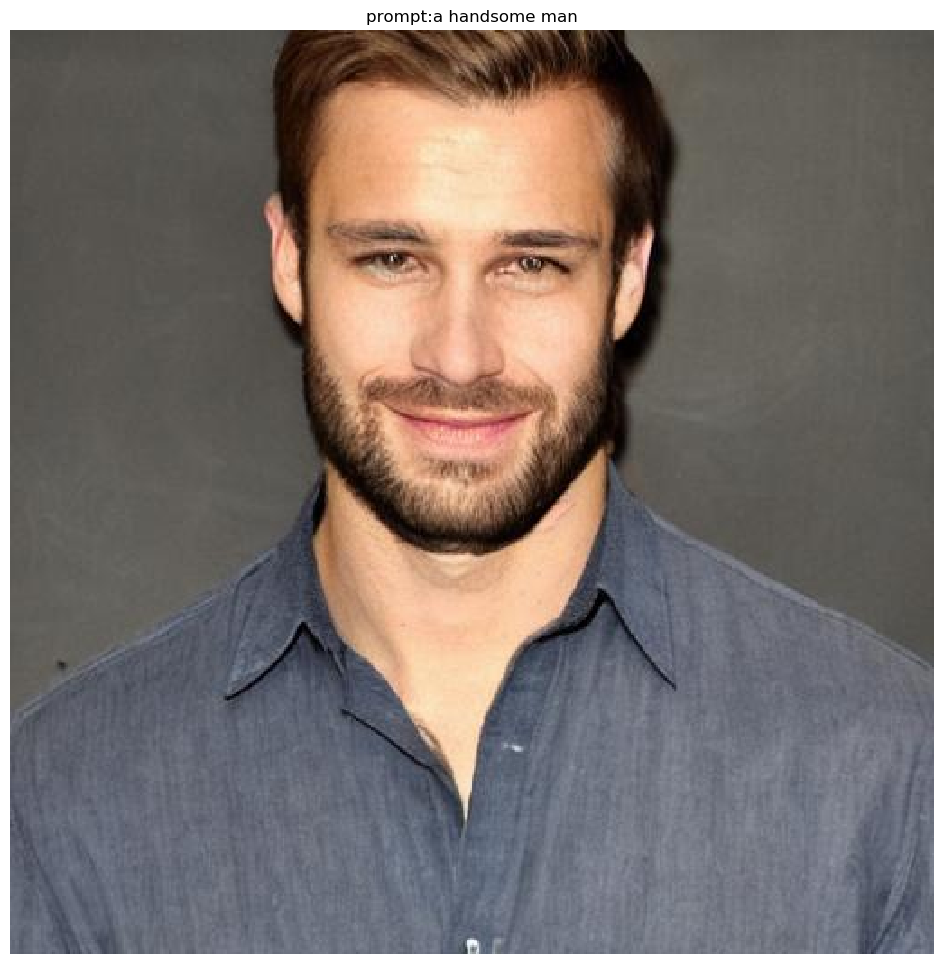

In [34]:
generate_prompt("a handsome man")

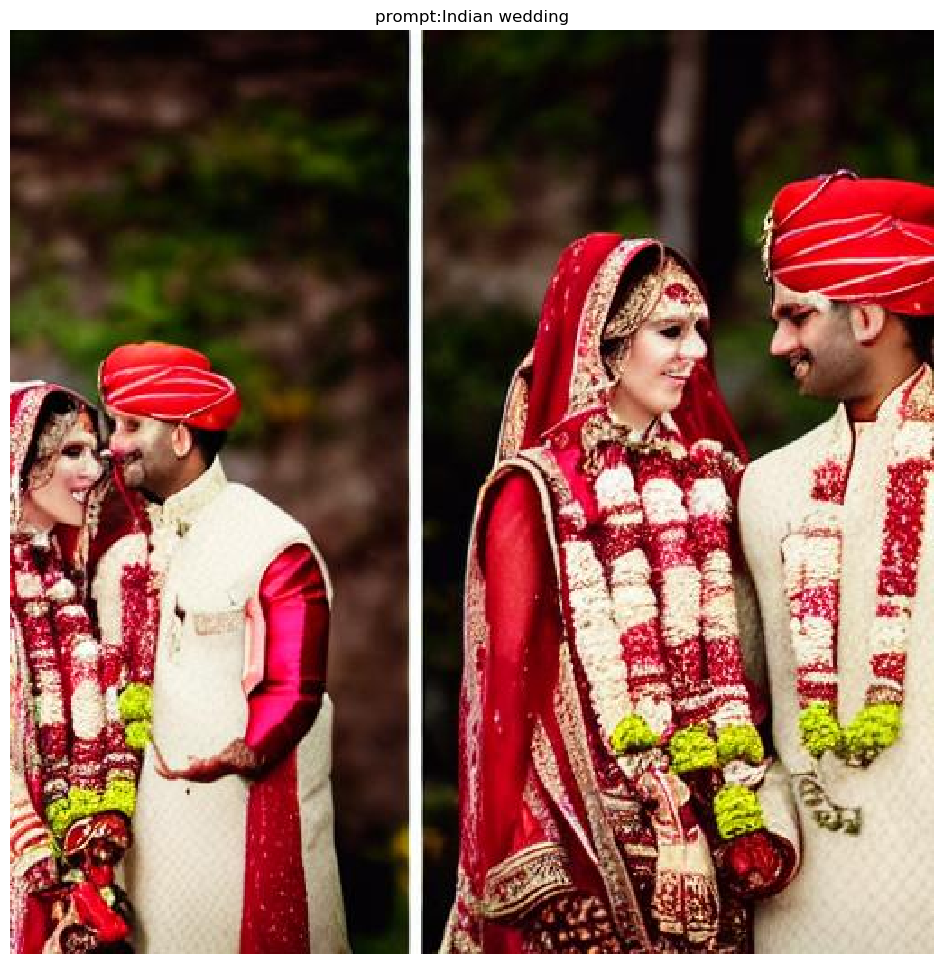

In [85]:
generate_prompt("Indian wedding")

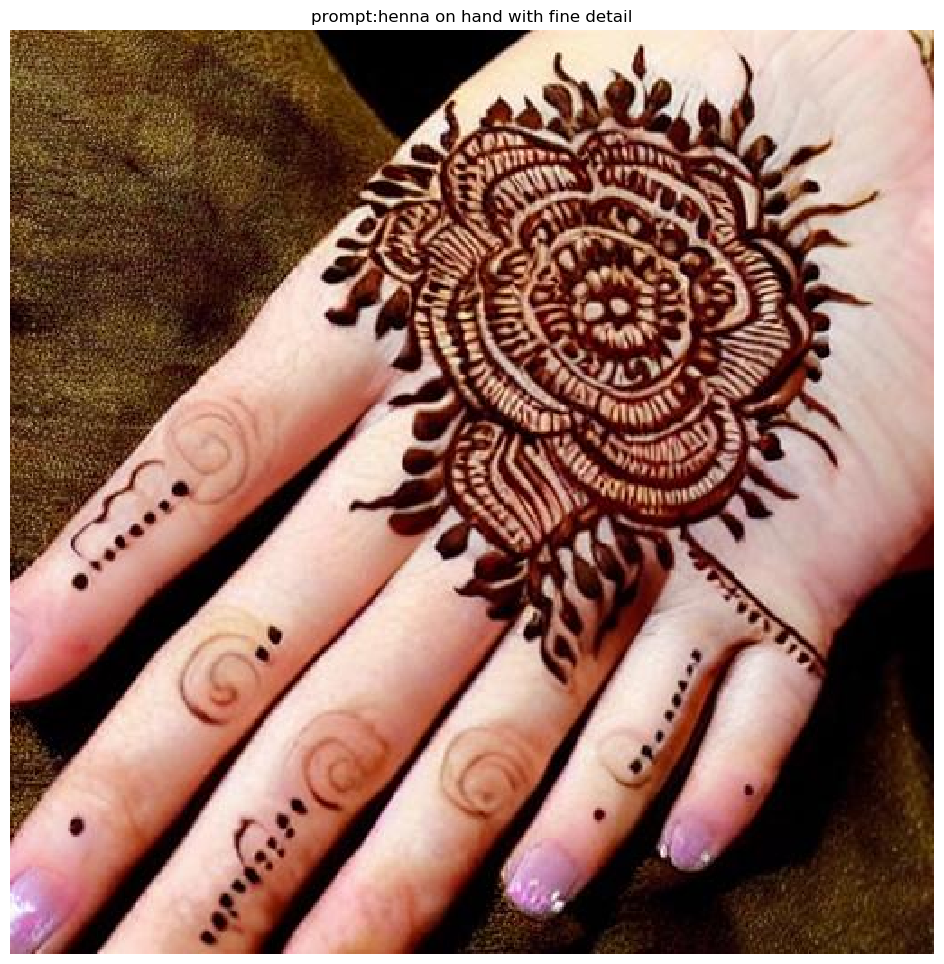

In [64]:
generate_prompt("henna on hand with fine detail")

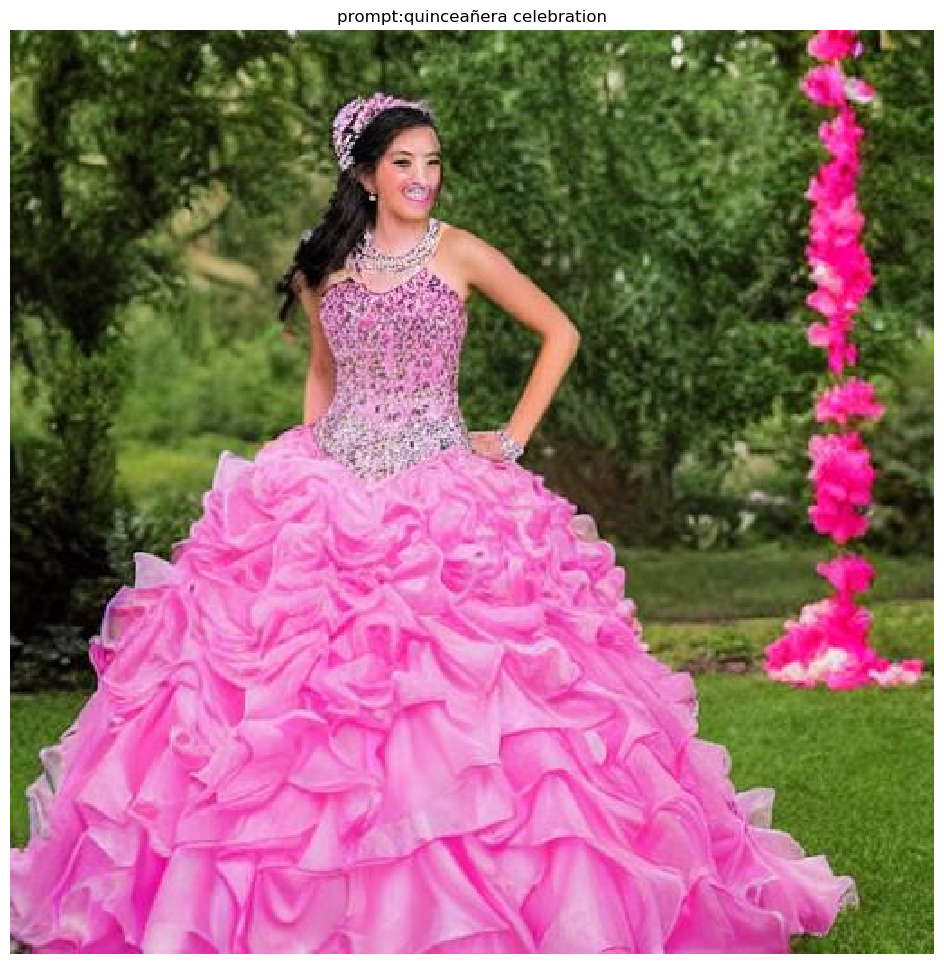

In [86]:
generate_prompt("quinceañera celebration")

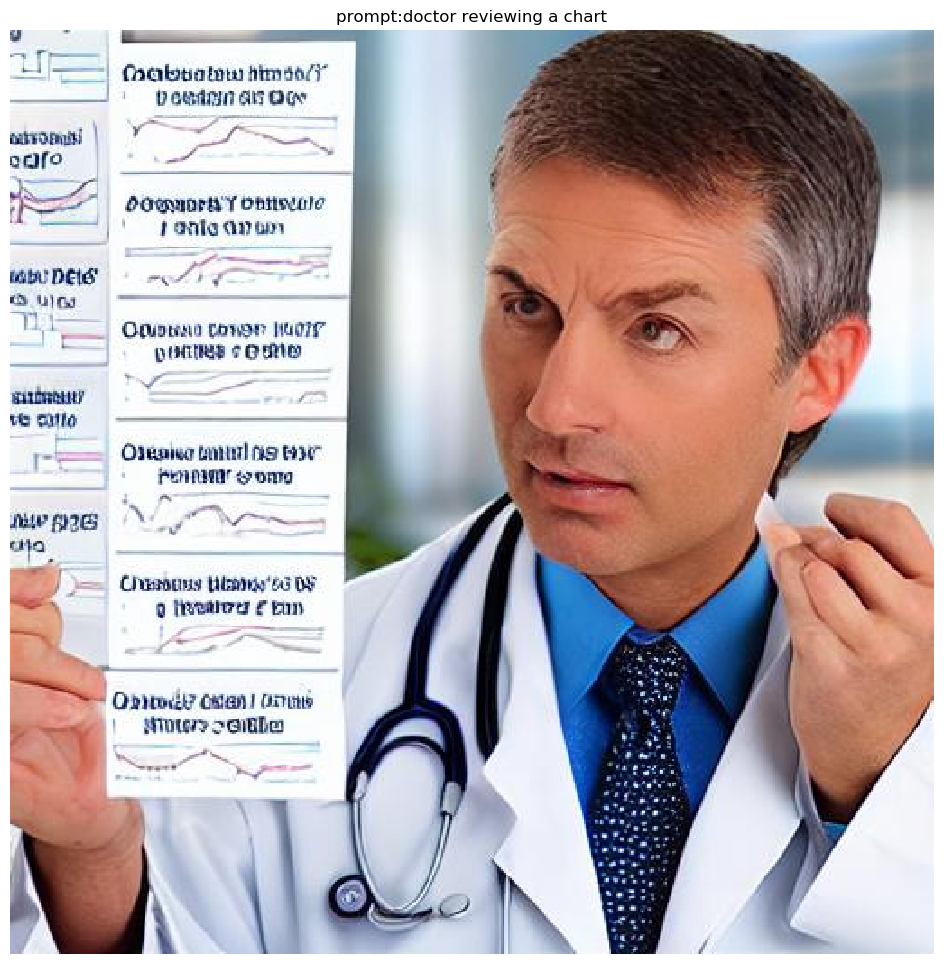

In [67]:
generate_prompt("doctor reviewing a chart")

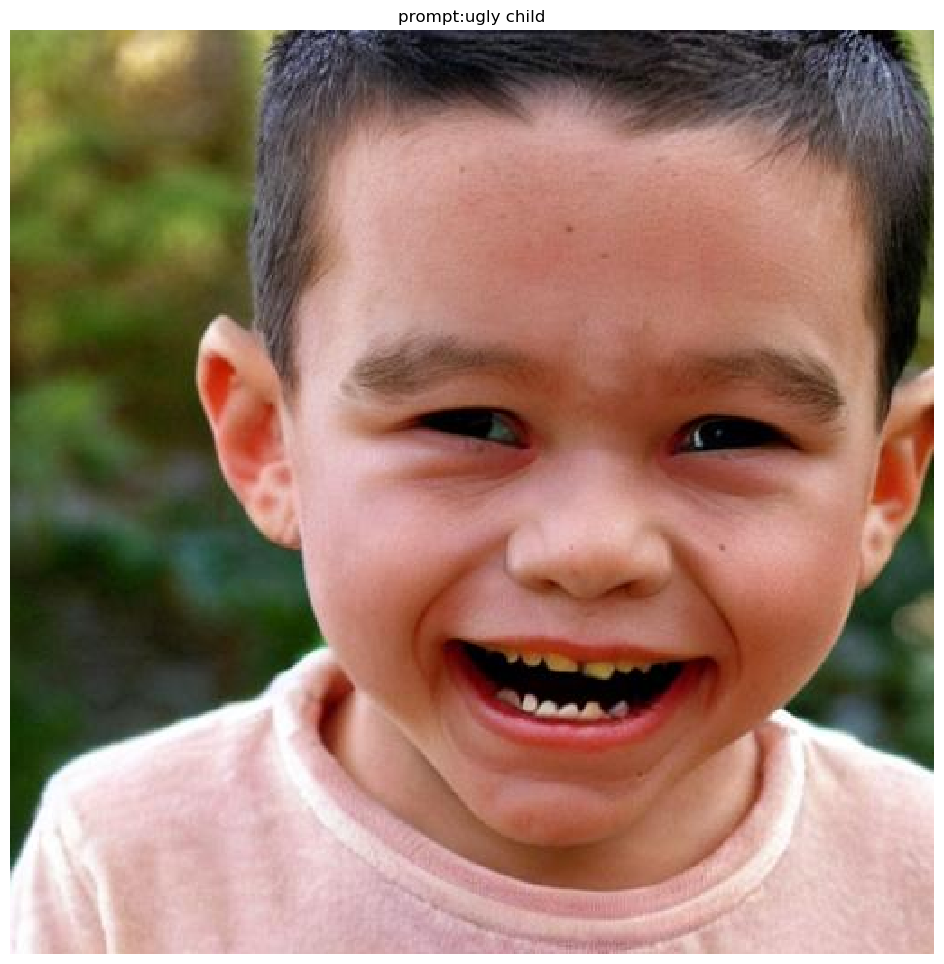

In [83]:
generate_prompt("ugly child")

In [41]:
#Tangible objects

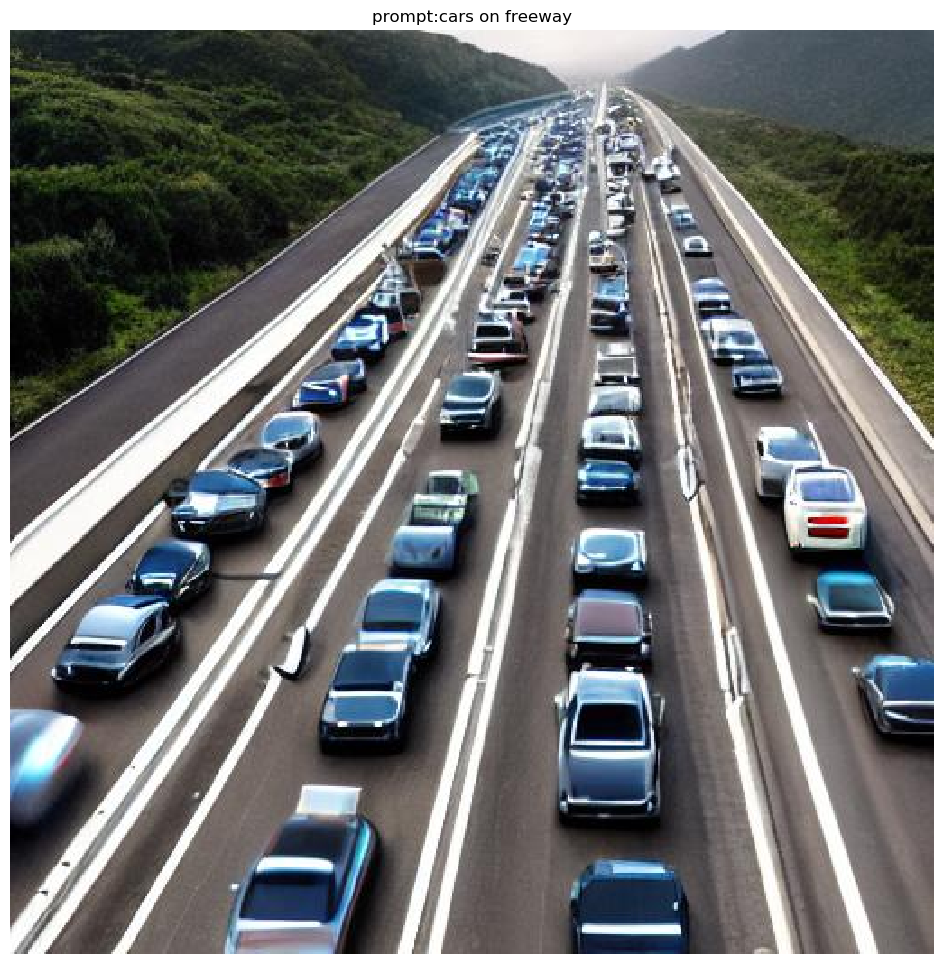

In [69]:
generate_prompt("cars on freeway")

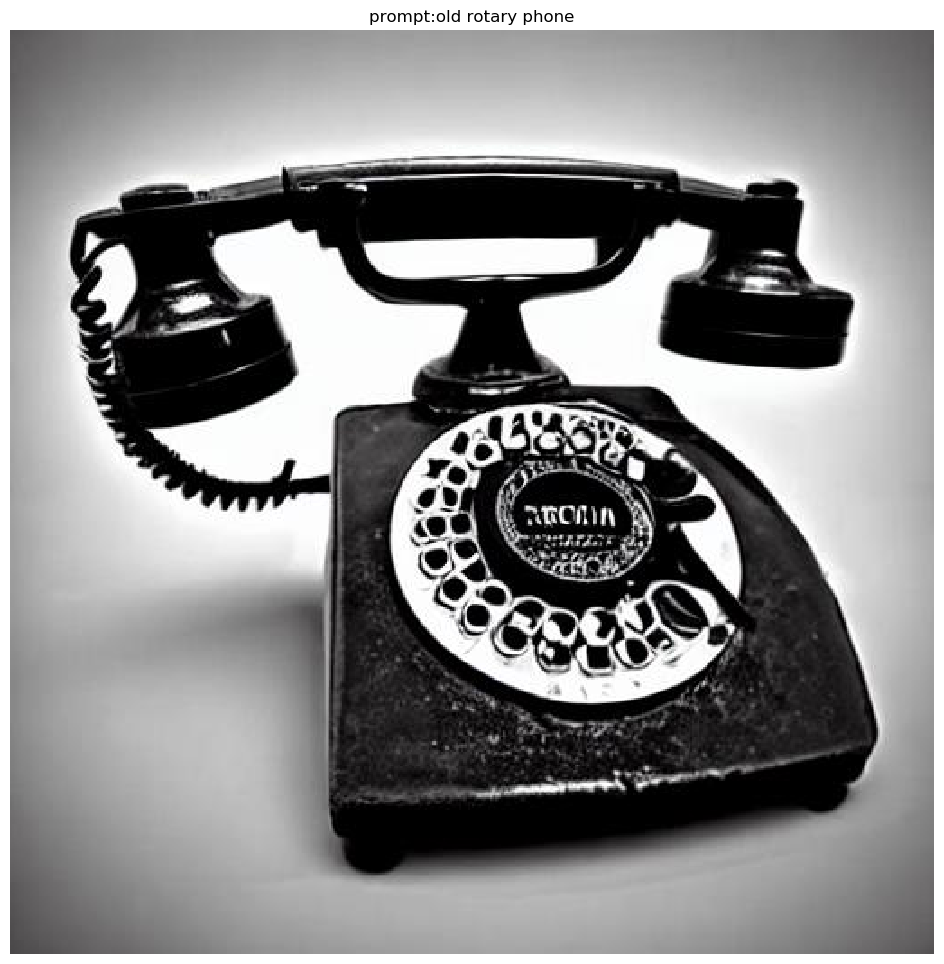

In [70]:
generate_prompt("old rotary phone")

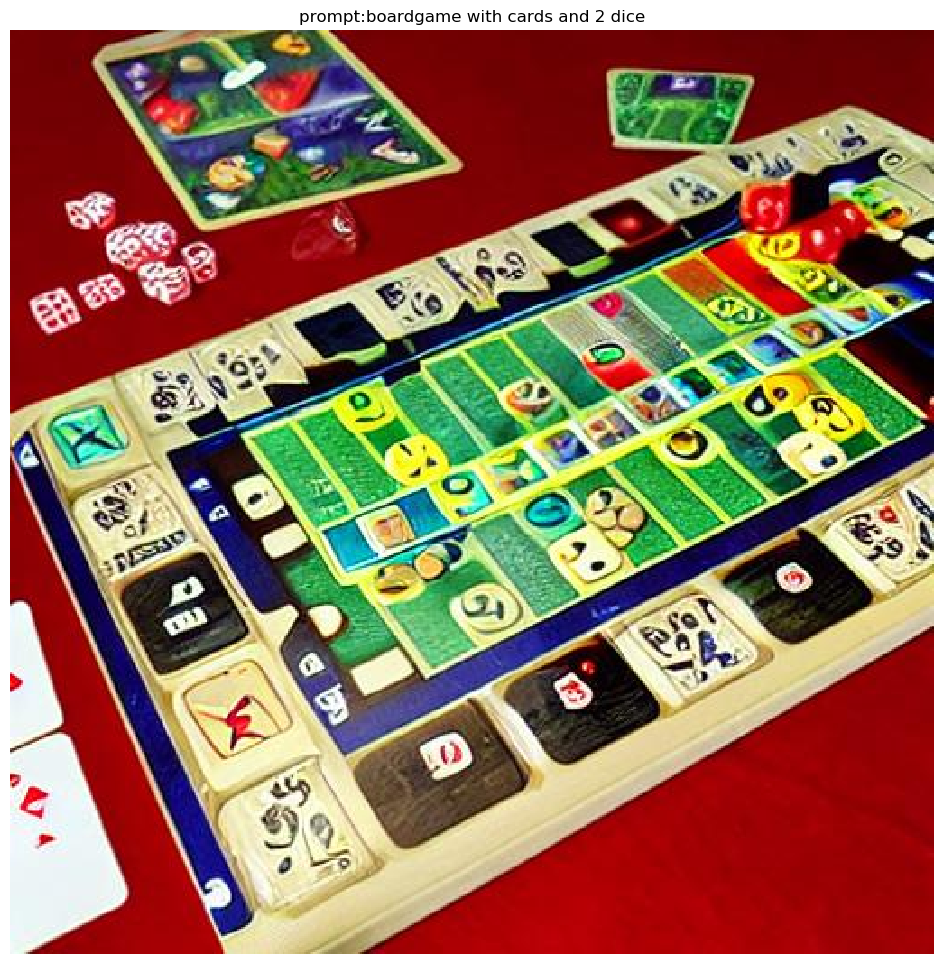

In [71]:
generate_prompt("boardgame with cards and 2 dice")

In [45]:
#Intangibles

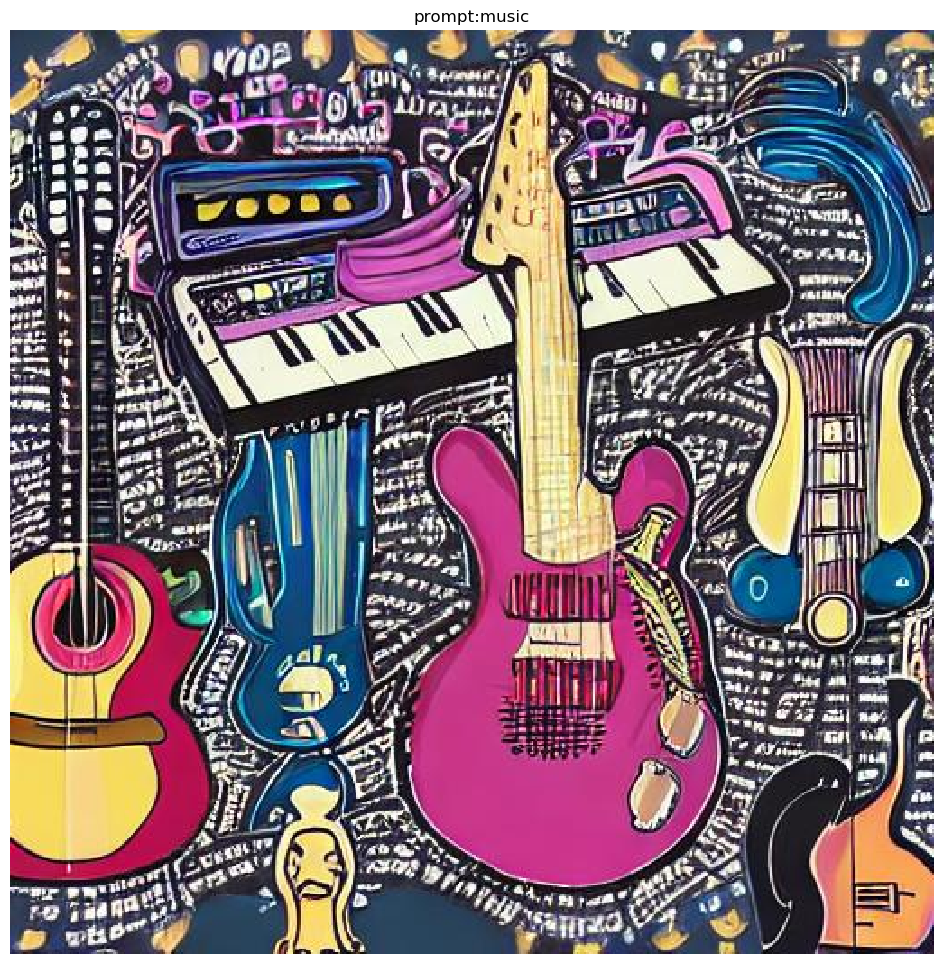

In [46]:
generate_prompt("music")

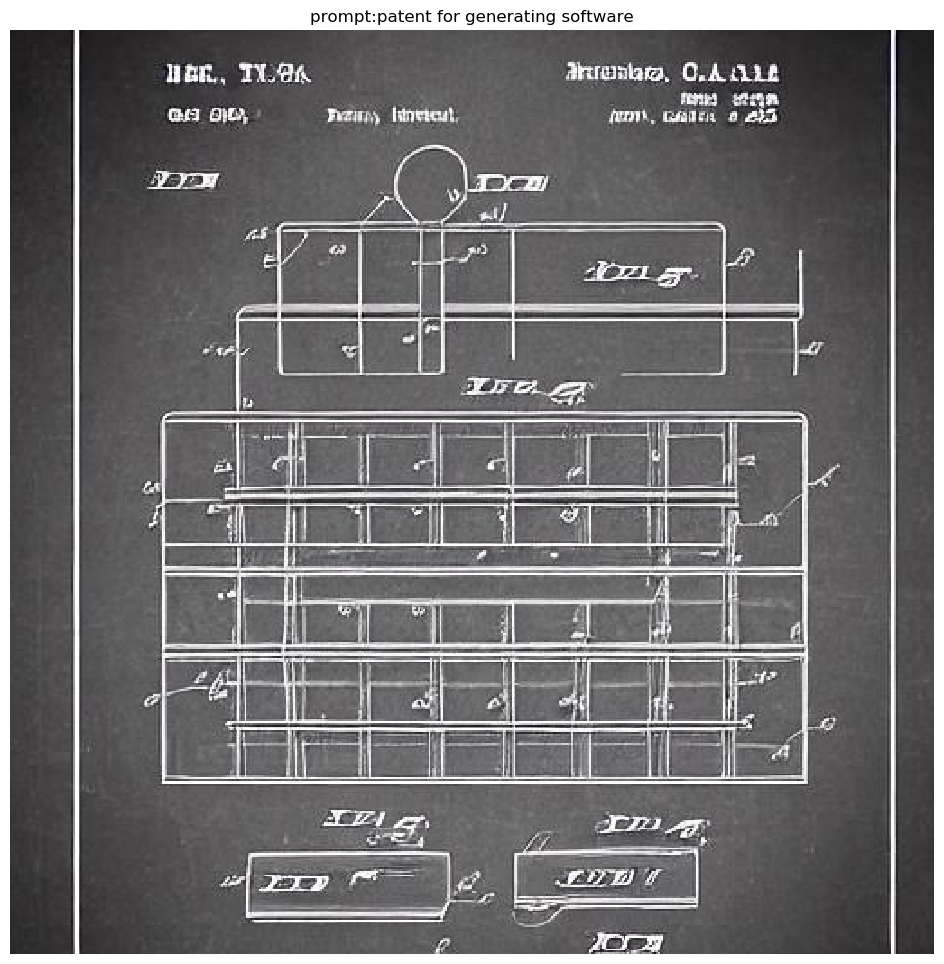

In [47]:
generate_prompt("patent for generating software")

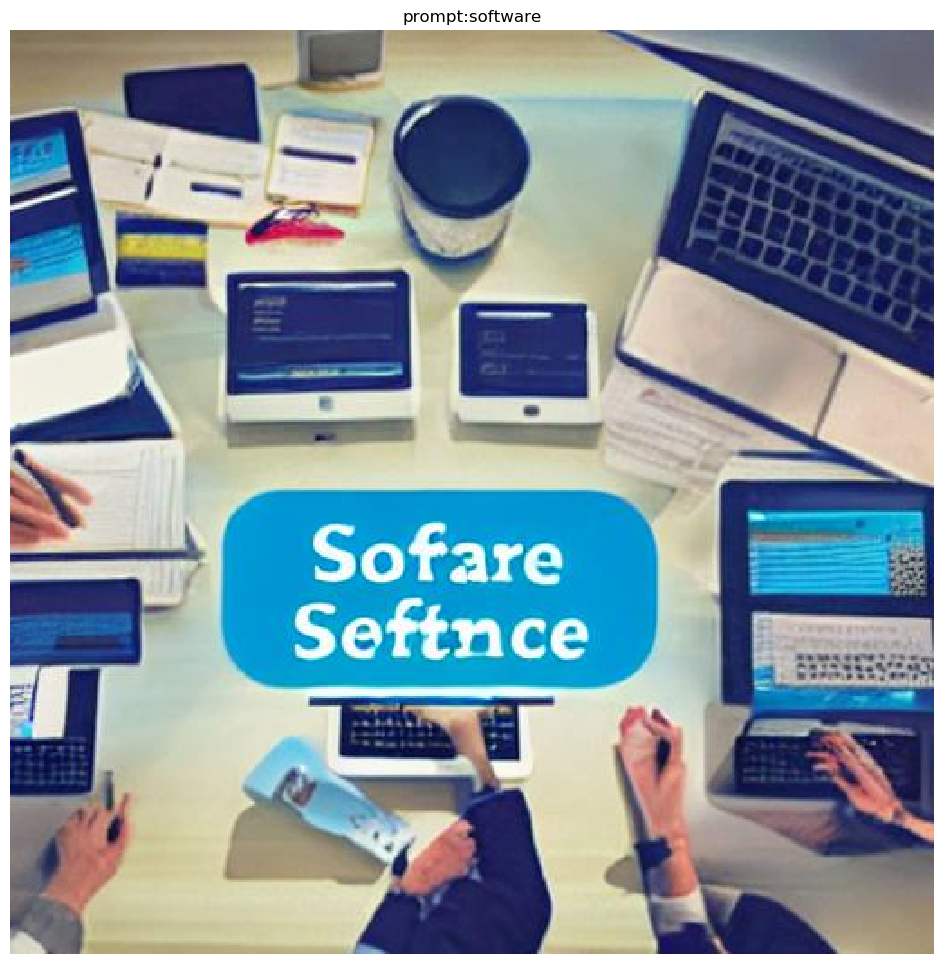

In [48]:
generate_prompt("software")

In [49]:
#Famous persons and locations

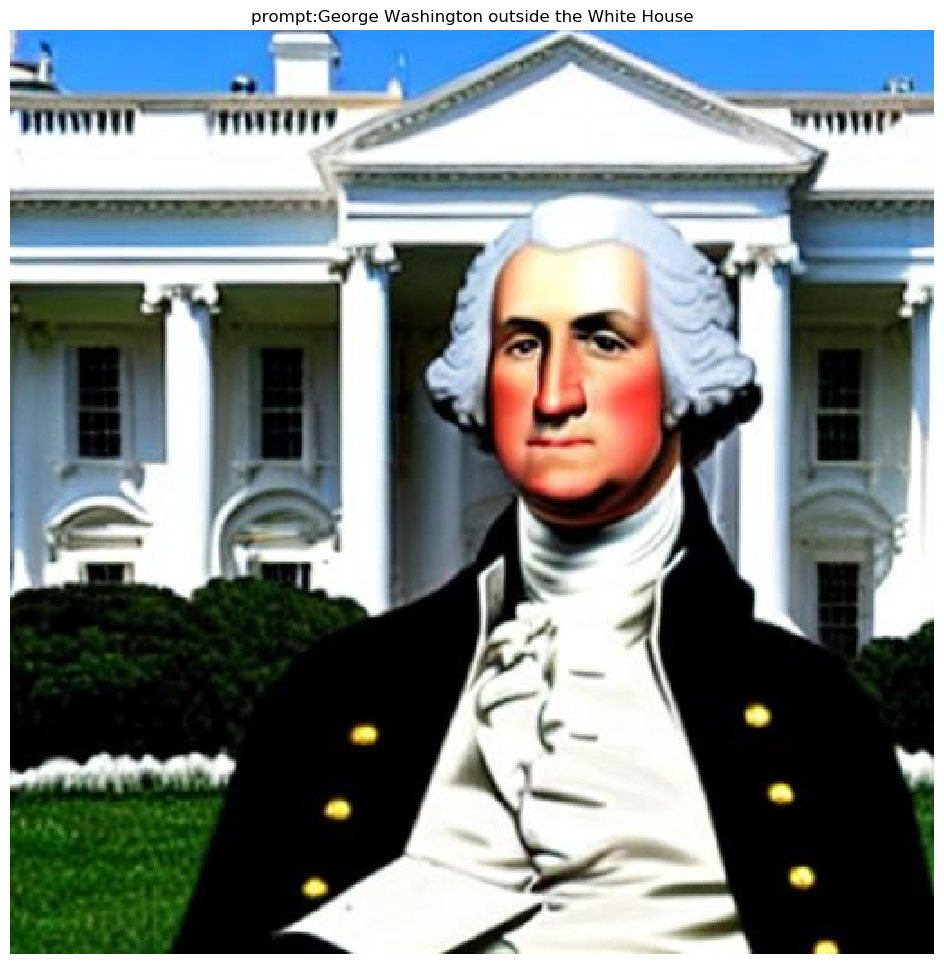

In [89]:
generate_prompt("George Washington outside the White House")

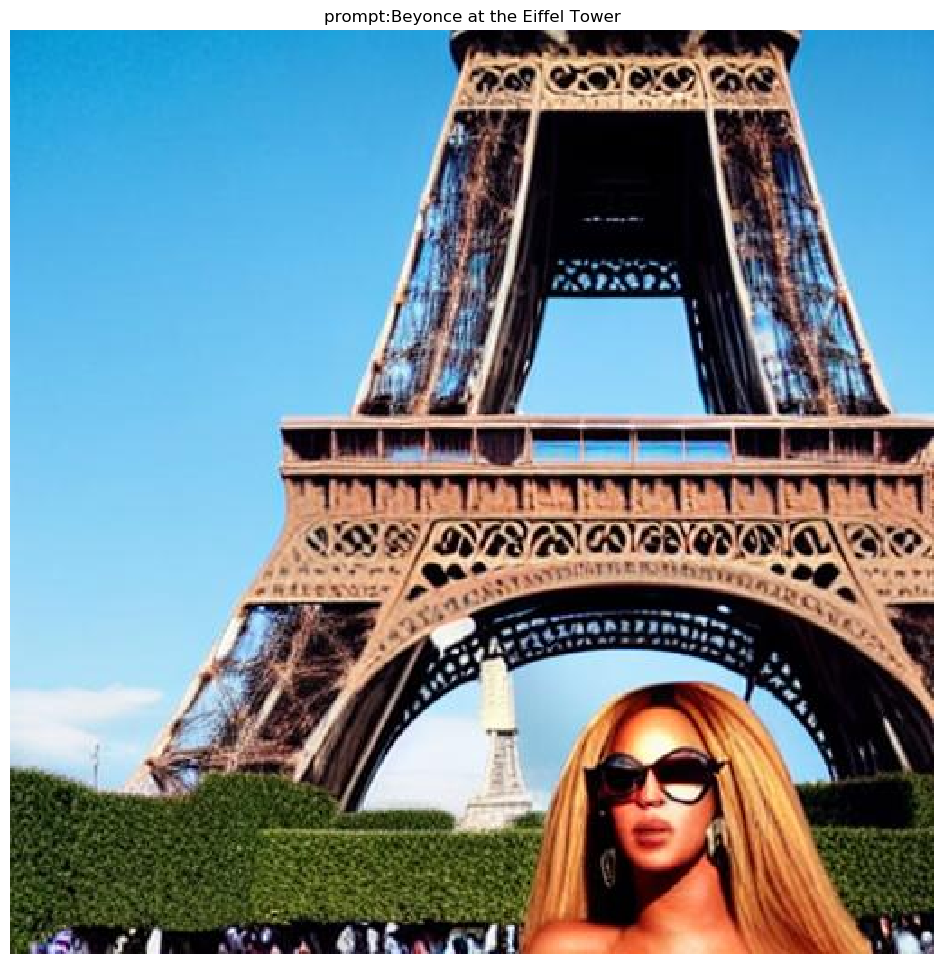

In [73]:
generate_prompt("Beyonce at the Eiffel Tower")

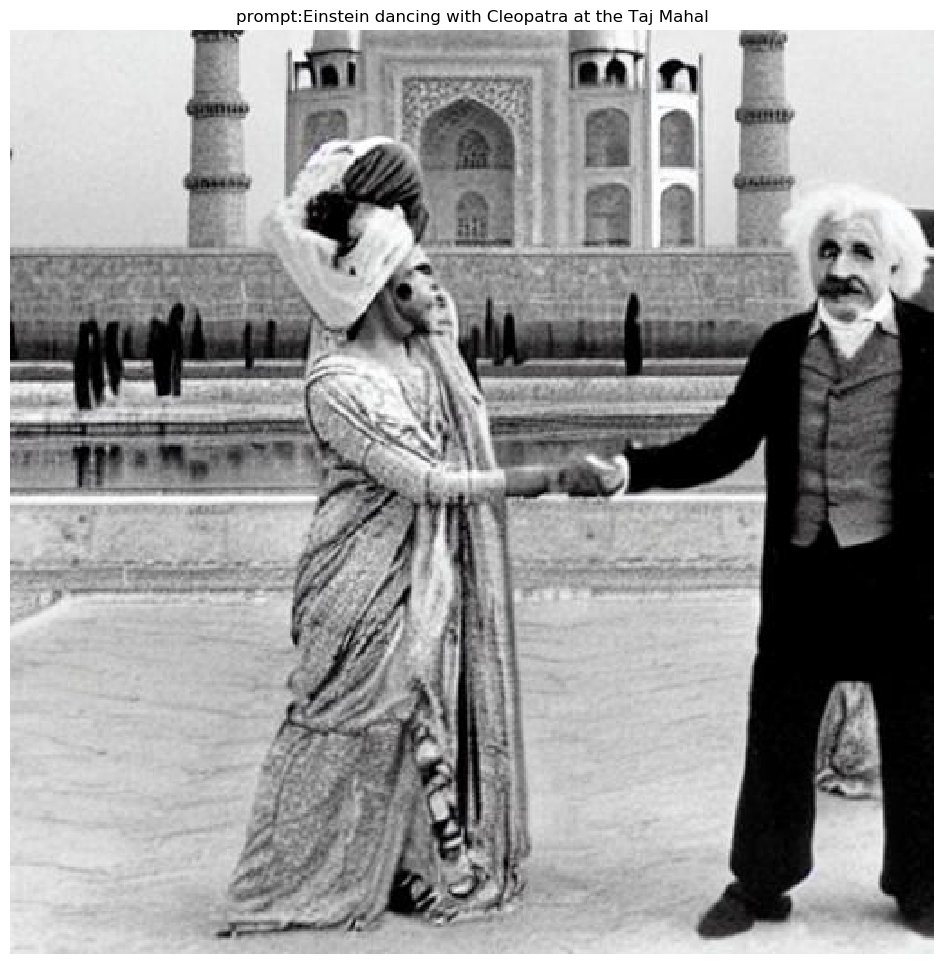

In [88]:
generate_prompt("Einstein dancing with Cleopatra at the Taj Mahal")

In [ ]:
#Fantasy and fiction

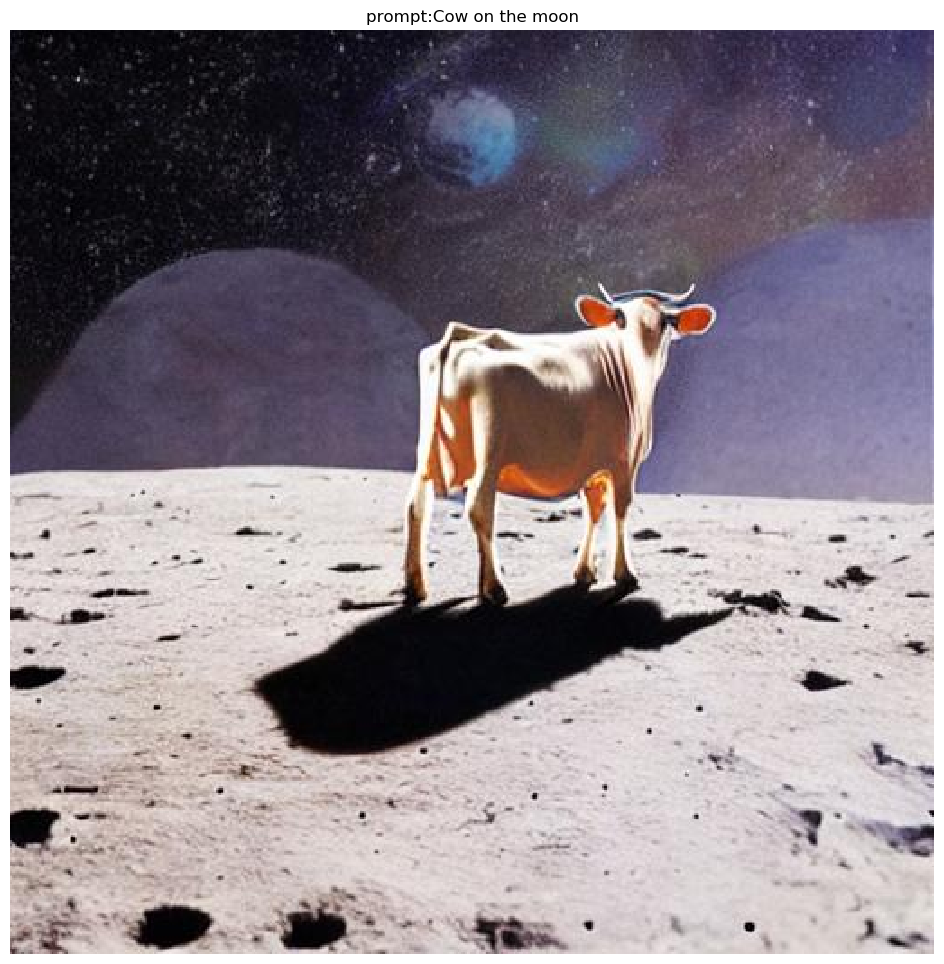

In [27]:
generate_prompt("Cow on the moon")

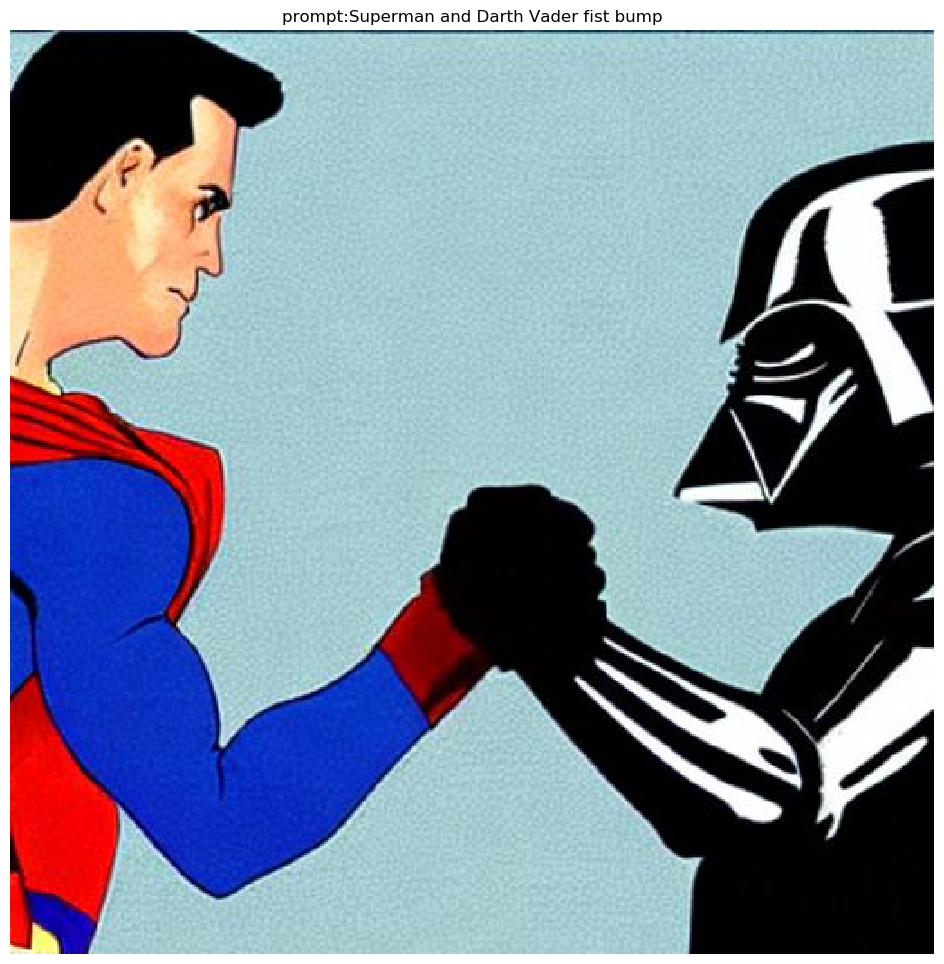

In [43]:
generate_prompt("Superman and Darth Vader fist bump")

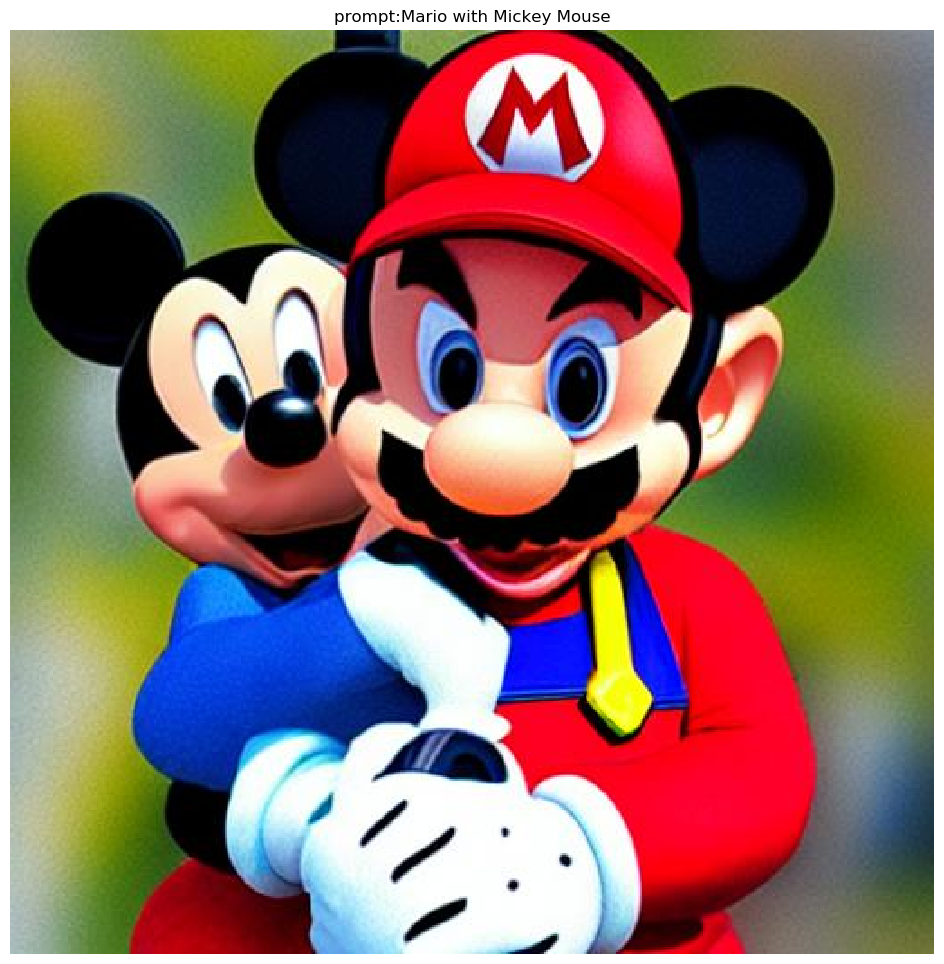

In [53]:
generate_prompt("Mario with Mickey Mouse")

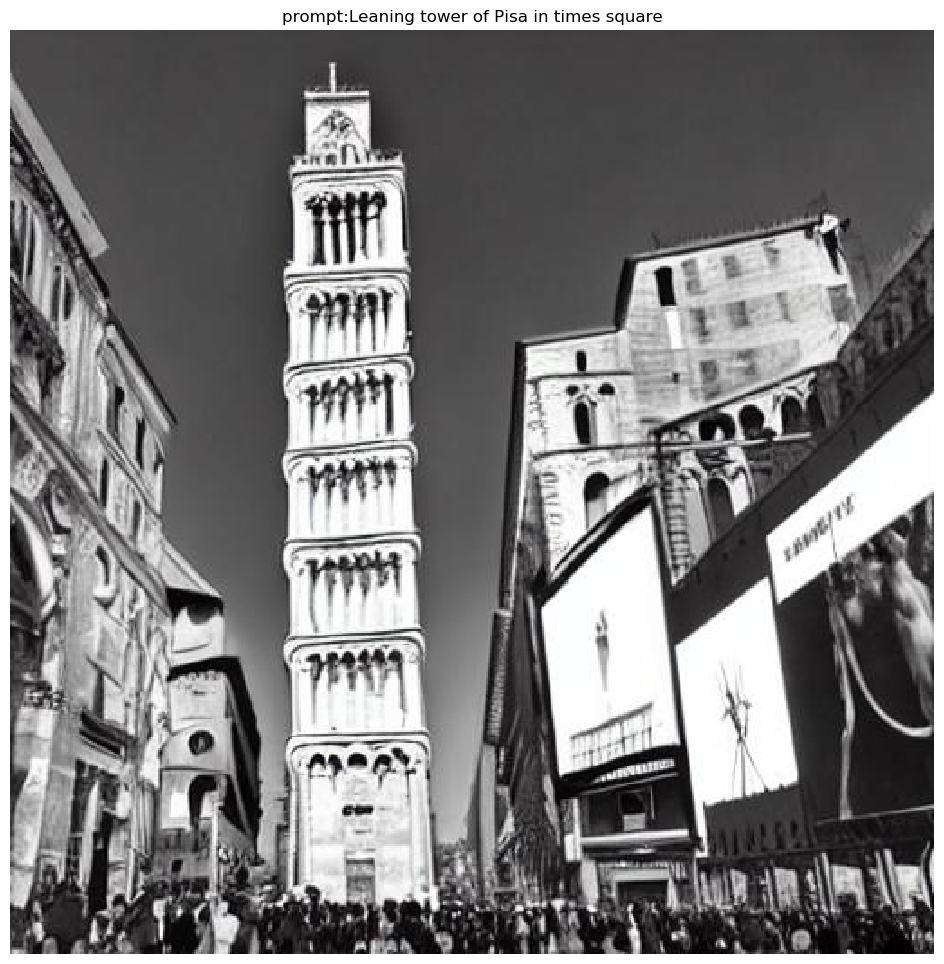

In [62]:
generate_prompt("Leaning tower of Pisa in times square")

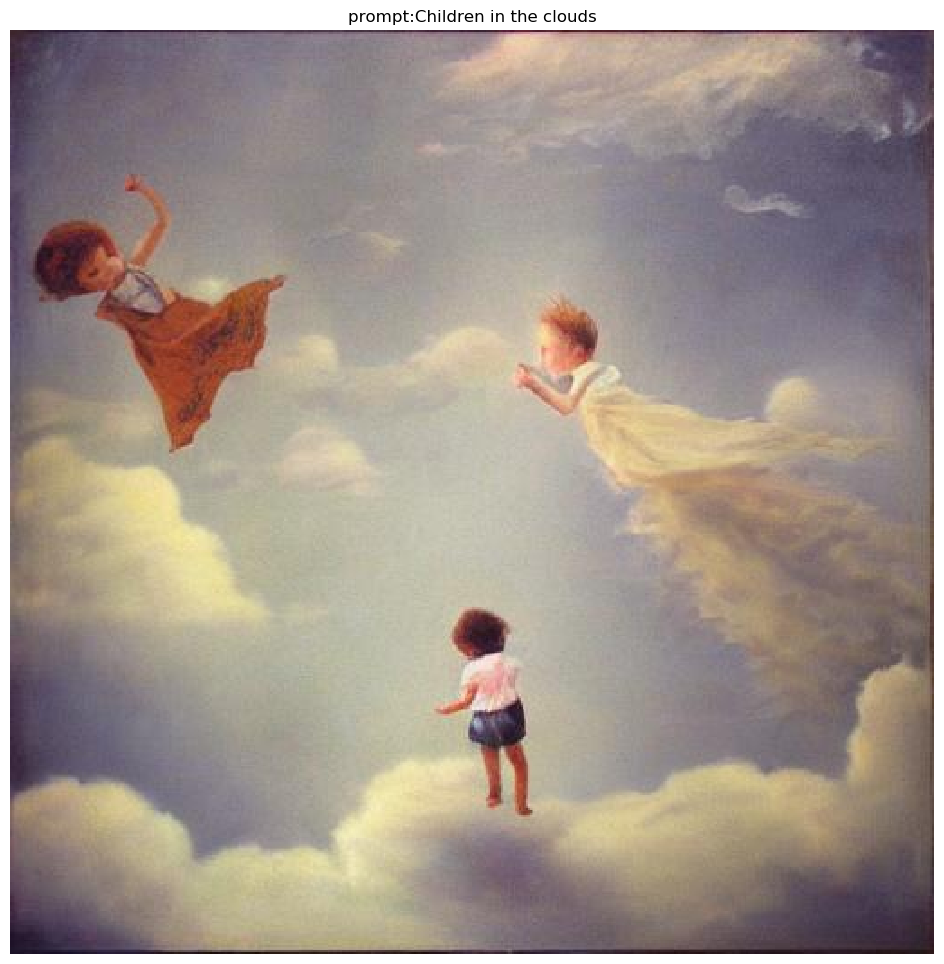

In [65]:
generate_prompt("Children in the clouds")

In [53]:
#Spanish

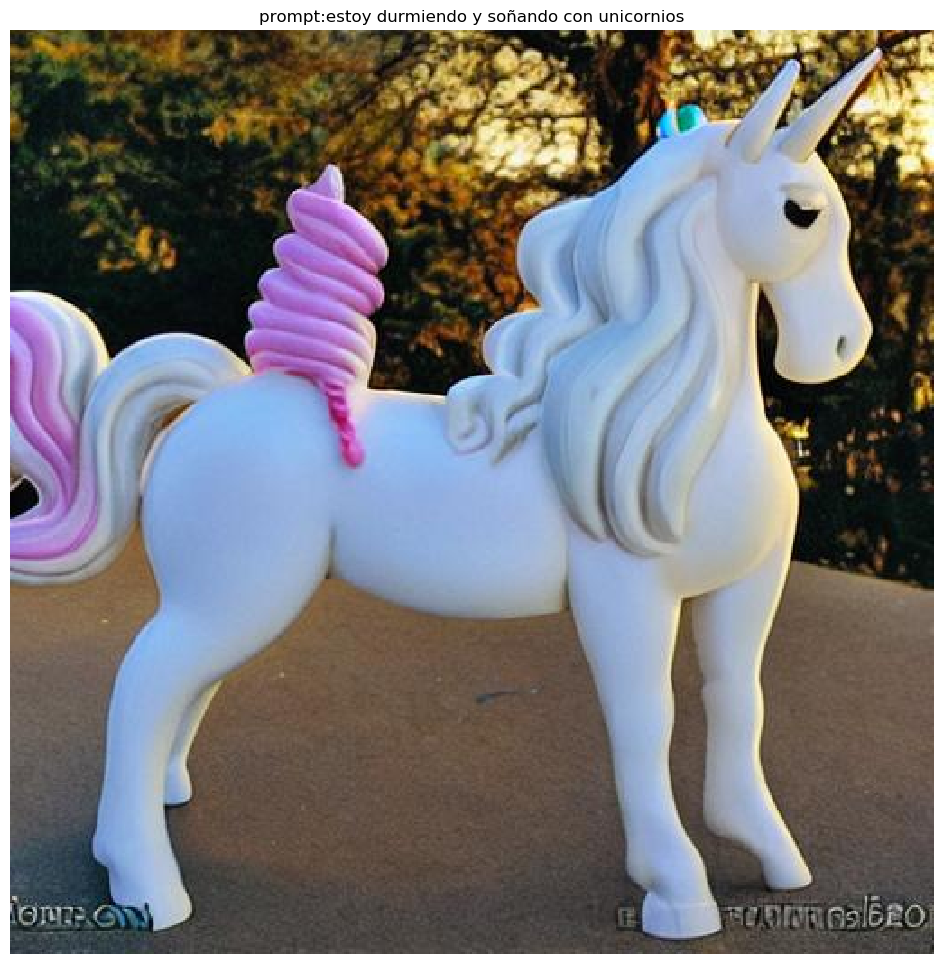

In [54]:
generate_prompt("estoy durmiendo y soñando con unicornios") 

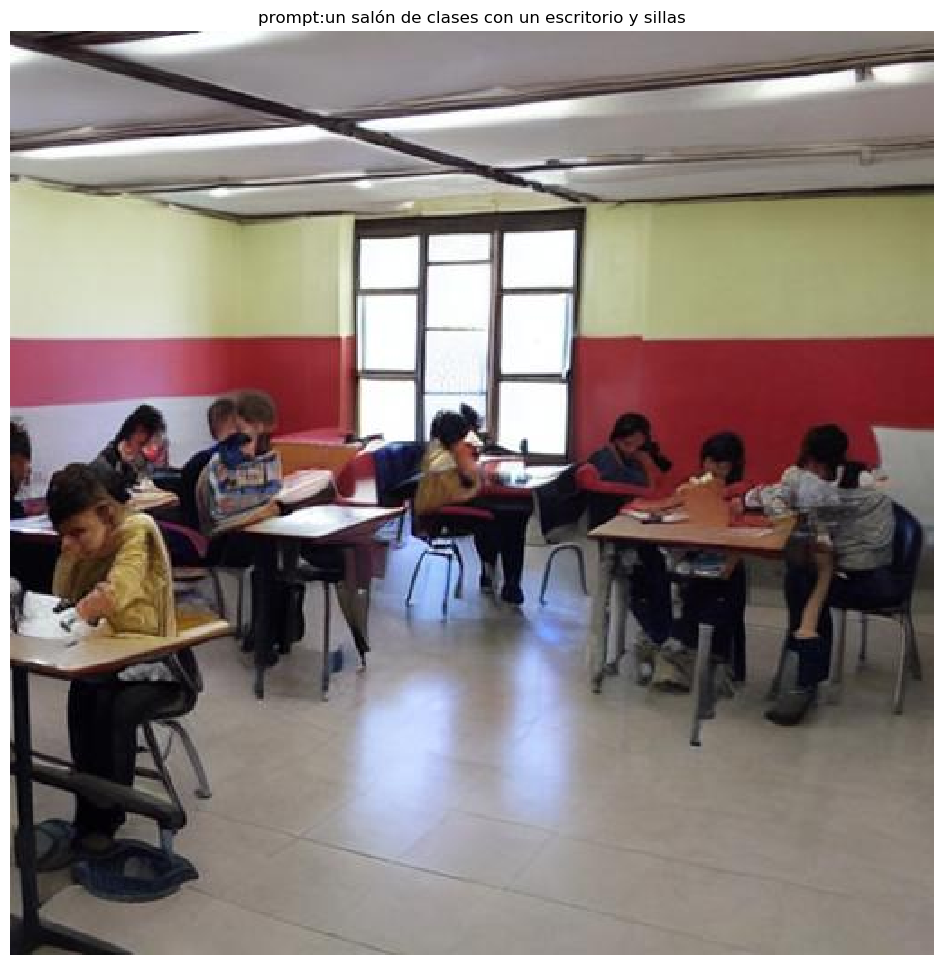

In [77]:
generate_prompt("un salón de clases con un escritorio y sillas")

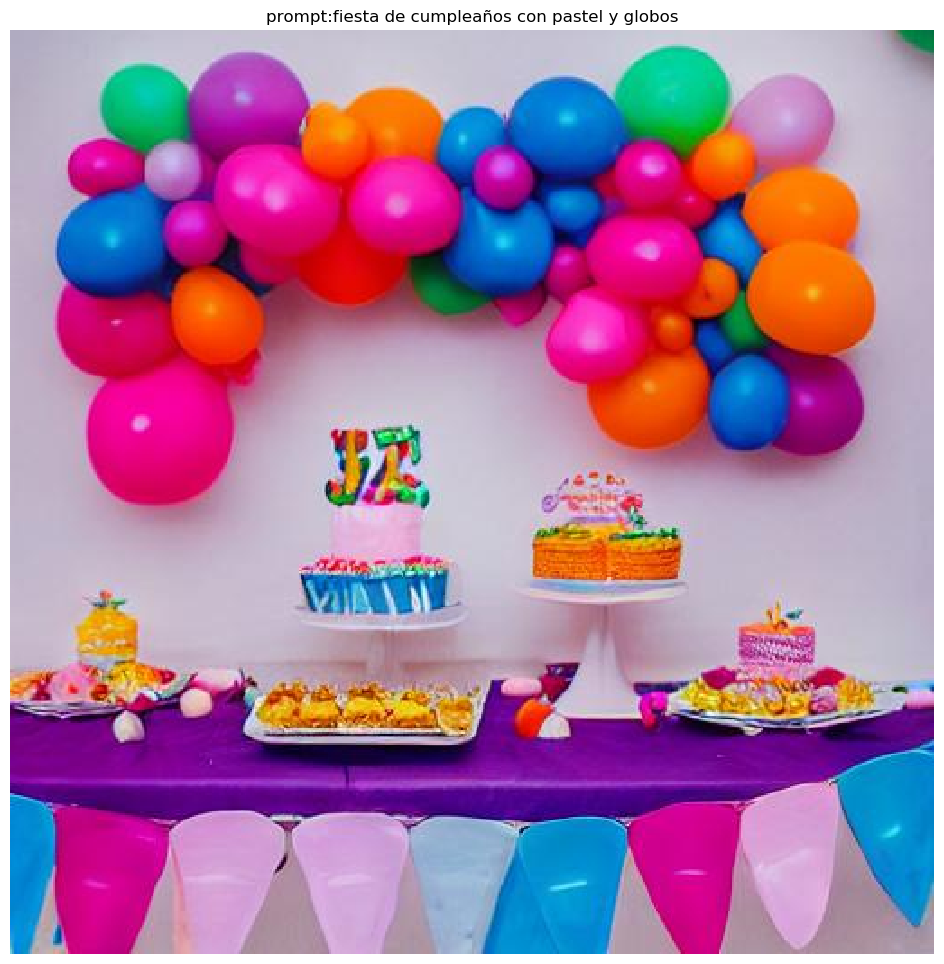

In [56]:
generate_prompt("fiesta de cumpleaños con pastel y globos") 

In [ ]:
#stable-diffusion-v1-5 for persons since it looks to create better photo real human faces

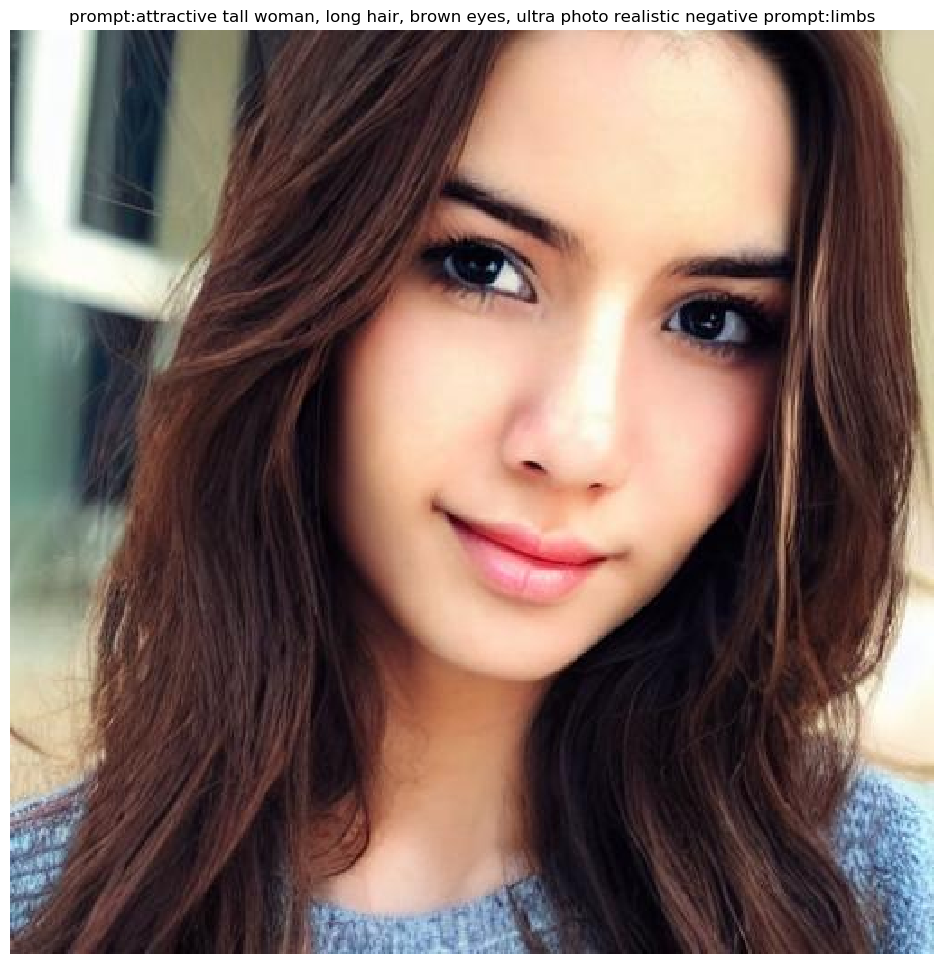

In [97]:
payload = {
    "prompt": "attractive tall woman, long hair, brown eyes, ultra photo realistic",
    "negative_prompt": "limbs",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 7.5
}
generate(payload)

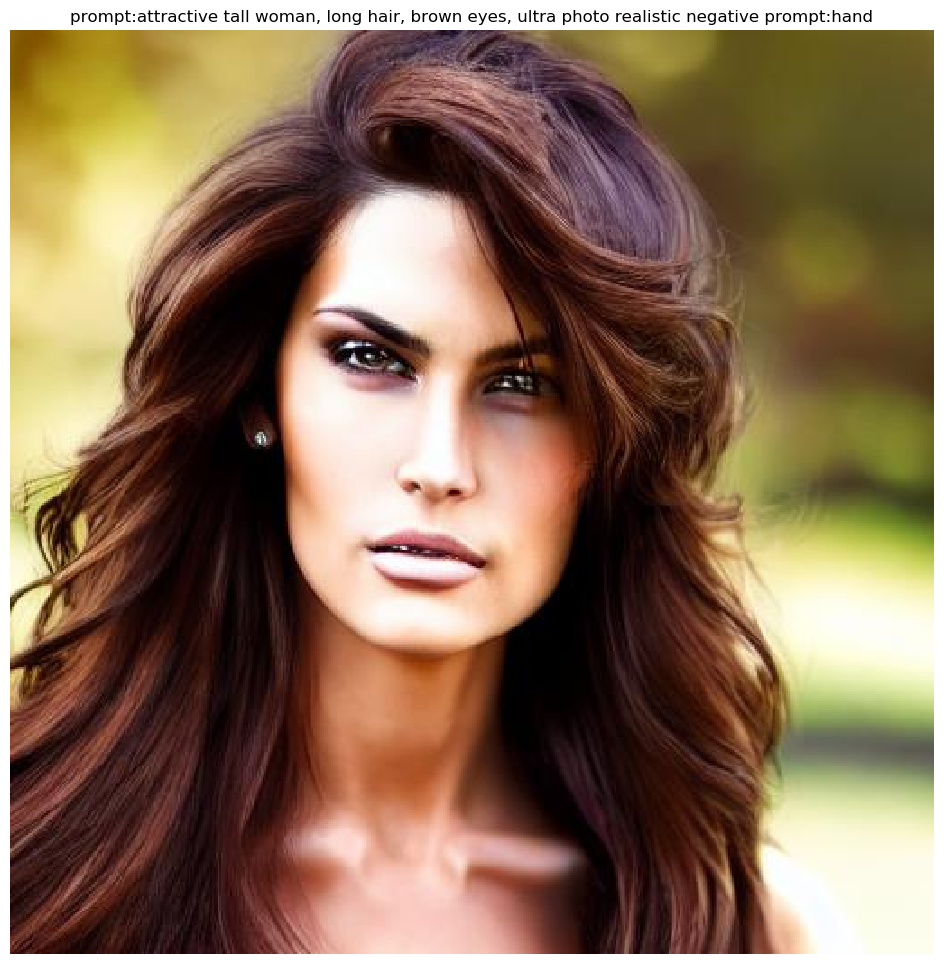

In [107]:
payload = {
    "prompt": "attractive tall woman, long hair, brown eyes, ultra photo realistic",
    "negative_prompt": "hand",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 20
}
generate(payload)

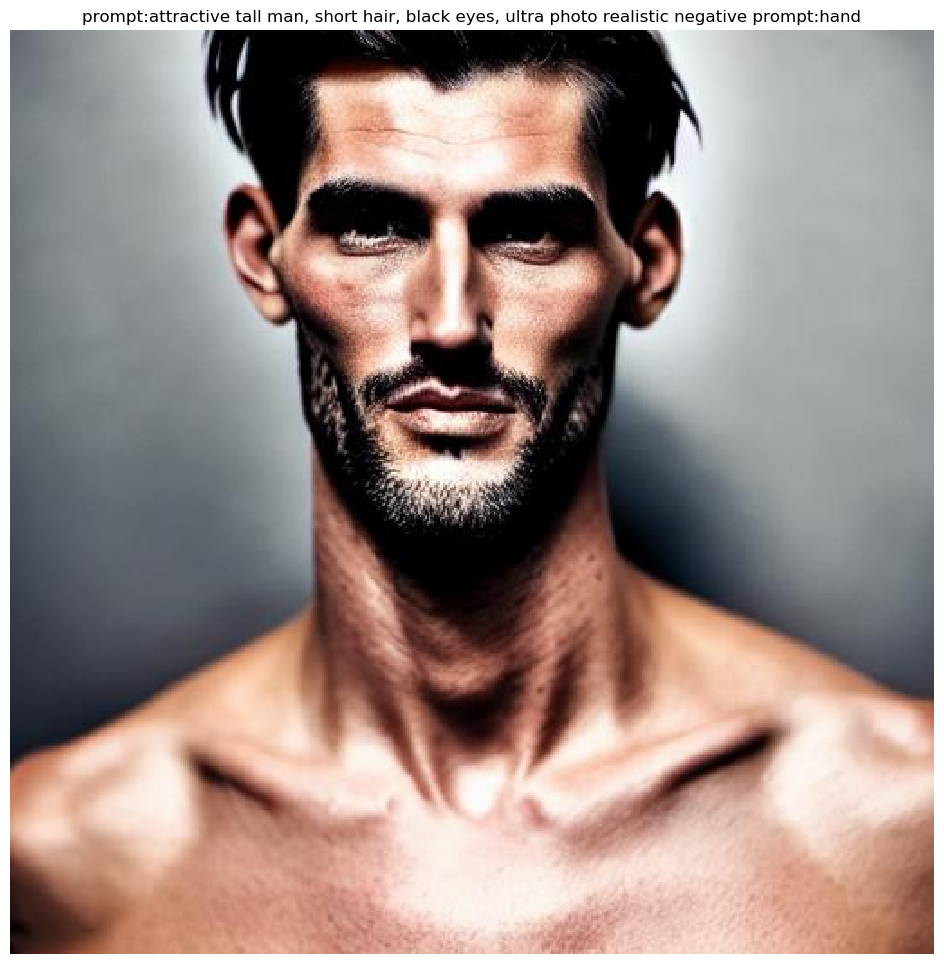

In [111]:
payload = {
    "prompt": "attractive tall man, short hair, black eyes, ultra photo realistic",
    "negative_prompt": "hand",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 20
}
generate(payload)

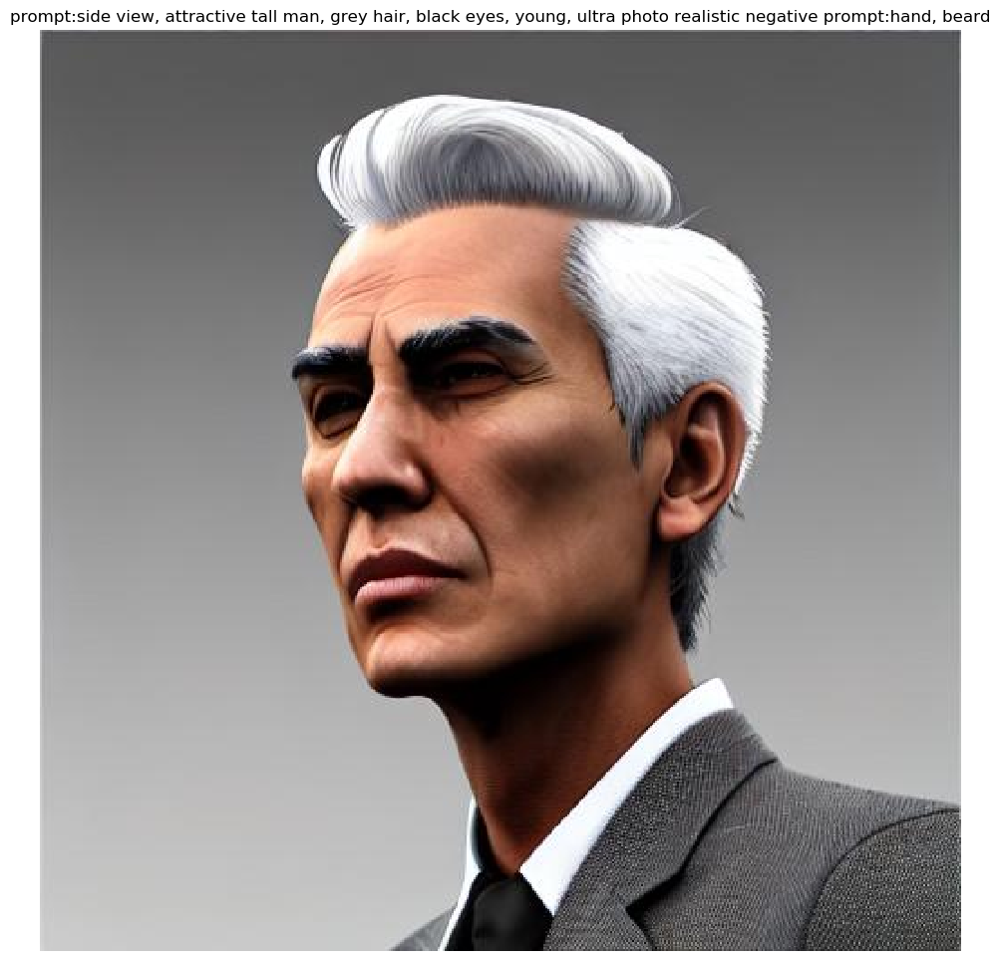

In [126]:
payload = {
    "prompt": "side view, attractive tall man, grey hair, black eyes, young, ultra photo realistic",
    "negative_prompt": "hand, beard",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 200,
    "guidance_scale": 20
}
generate(payload)

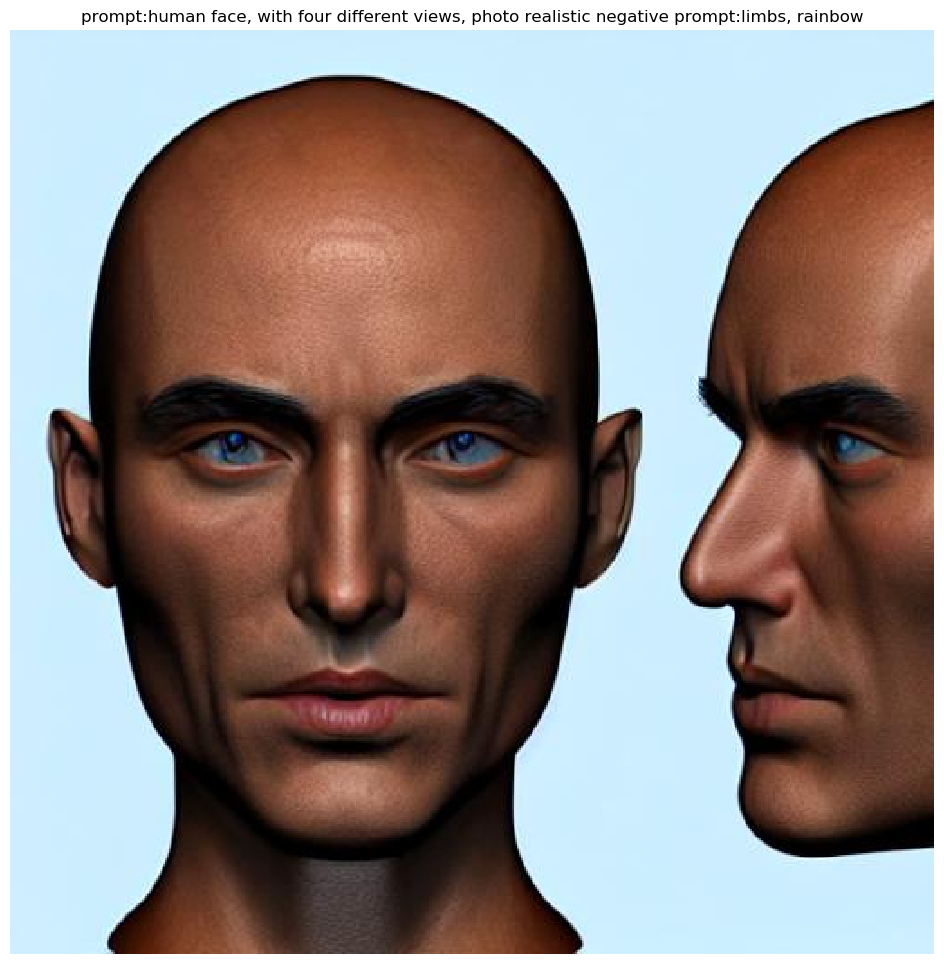

In [120]:
payload = {
    "prompt": "human face, with four different views, photo realistic",
    "negative_prompt": "limbs, rainbow",
    "width": 512,
    "height": 512,
    "num_images_per_prompt": 1,
    "num_inference_steps": 100,
    "guidance_scale": 20
}
generate(payload)

In [66]:
#Delete to stop incurring cost
model_predictor.delete_model()
model_predictor.delete_endpoint()